<a href="https://colab.research.google.com/github/Carlos-Muniz/Fraud-Detection-Classifier/blob/master/Fraud_Detection_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fraud Detection Classifier Notebook

*   **Problem:** Fraud Detection - Binary Classifier
*   **Dataset:** [Synthetic Financial Dataset for Fraud Detection](https://www.kaggle.com/ntnu-testimon/paysim1)
*   **Methods:** An assortment of Networks built using PyTorch
*   **Evaluation:** Accuracy, Precision, Recall, and F1 Scores
<!-- *    -->

## Contents

1.   Import Libraries
2.   Load Dataset
3.   Exploratory Data Analysis
4.   Feature Engineering
5.   Network Classes
6.   Training and Testing
7.   Evaluation






# Import Libraries

In [1]:
import zipfile
import pandas as pd
import seaborn as sns
import numpy as np
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler
import tqdm
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Load Dataset

Download the zip file from the kaggle [LINK](https://www.kaggle.com/ntnu-testimon/paysim1) and place in the root folder unzipped.

In [2]:
file_path = '1069_1940_compressed_PS_20174392719_1491204439457_log.csv.zip'
with zipfile.ZipFile(file_path, 'r') as zipf:
    with zipf.open('PS_20174392719_1491204439457_log.csv') as fin:
        data = pd.read_csv(fin)

# Exploratory Data Analysis

In [3]:
# Rename faulty column, 
data = data.rename(columns={'oldbalanceOrg': 'oldbalanceOrig'})
data.head()

,step,type,amount,nameOrig,oldbalanceOrig,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0,0
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0,0
2,1,TRANSFER,181.00,C1305486145,181.0,0.00,C553264065,0.0,0.0,1,0
3,1,CASH_OUT,181.00,C840083671,181.0,0.00,C38997010,21182.0,0.0,1,0
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0,0


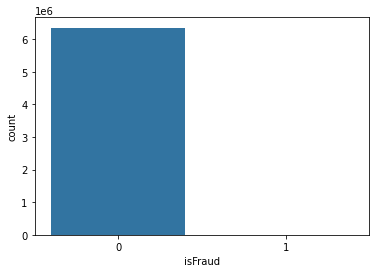

In [4]:
sns.countplot(data['isFraud'])

**There are far more negative samples than postive samples.**

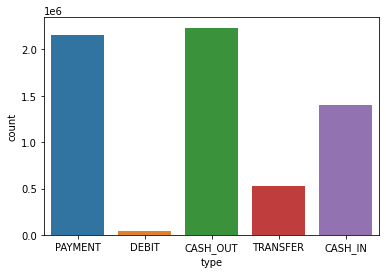

In [5]:
sns.countplot(data[data['isFraud'] == 0]['type'])

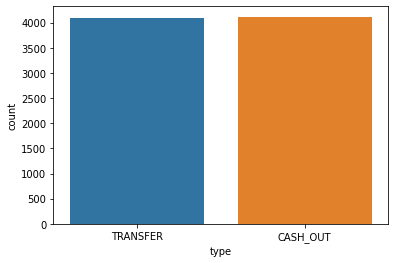

In [6]:
sns.countplot(data[data['isFraud'] == 1]['type'])

**Positve samples of Fraud only occur in two Types: Transfer and Cash-Out**

In [7]:
fraud = data[data['isFraud']==1]
notFraud = data[data['isFraud']==0]

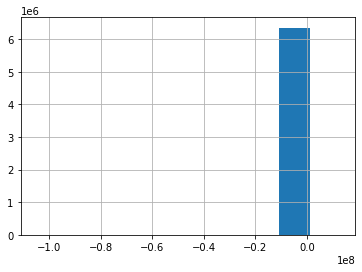

In [8]:
((notFraud['oldbalanceOrig'] - notFraud['newbalanceOrig']) -
 (notFraud['newbalanceDest'] - notFraud['oldbalanceDest'])).hist()

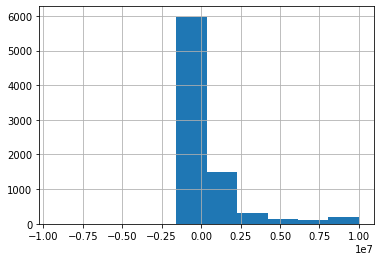

In [9]:
((fraud['oldbalanceOrig'] - fraud['newbalanceOrig']) -
 (fraud['newbalanceDest'] - fraud['oldbalanceDest'])).hist()

**In many cases of Fraud, there is a noticeable positive difference between the difference between Original balance, and the difference between the Destination balance**

# Feature Engineering

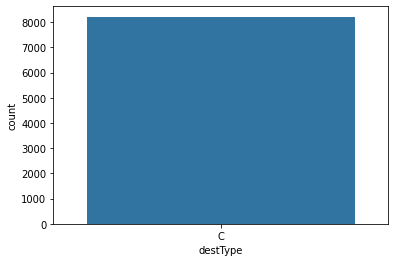

In [10]:
data['destType'] = data['nameDest'].apply(lambda x: x[0])
sns.countplot(data[data['isFraud'] == 1]['destType'])

**Account destinations start with either M or C, so we add this as a feature.**

**Fraud only ever comes from Destination accounts of type C, never type M (for Merchant)**

In [11]:
data['oldbalanceDiff'] = data['oldbalanceOrig'] - data['newbalanceOrig']
data['newbalanceDiff'] = data['newbalanceDest'] - data['oldbalanceDest']
data['balanceDiff'] = data['oldbalanceDiff'] - data['newbalanceDiff']

# Network Classes

## Dataset Class

In [12]:
class Encoder(torch.utils.data.Dataset):
    def __init__(self, dataframe, seed=1):
        # Balancing the dataset
        pos = dataframe[dataframe['isFraud']==1]
        neg = dataframe[dataframe['isFraud']==0].sample(
            len(pos), random_state=seed)
        df = pd.concat([pos, neg])
        # categorical columns into One-Hot vectors
        catCols = ['type', 'destType']
        catVecs = pd.get_dummies(df[catCols]).values
        # continuous columns into Min-Max vectors
        contCols = ['amount', 'newbalanceDiff', 'oldbalanceDiff',
                    'balanceDiff']
        scaler = MinMaxScaler()
        contVecs = scaler.fit_transform(df[contCols])
        # compound vectors
        self.targets = np.hstack([catVecs, contVecs])
        self.labels = df['isFraud'].values
    
    def __getitem__(self, i):
        return self.targets[i, :], self.labels[i]
    
    def __len__(self):
        return len(self.targets)

In [13]:
dataset = Encoder(data)
train_size = int(0.65 * len(dataset))
validation_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - validation_size
train_set, validation_set, test_set = torch.utils.data.random_split(
    dataset, [train_size, validation_size, test_size])

In [14]:
np.random.seed(1)
train_loader = torch.utils.data.DataLoader(
    train_set, batch_size=821, shuffle=True)
validation_loader = torch.utils.data.DataLoader(
    validation_set, batch_size=821, shuffle=True)
test_loader = torch.utils.data.DataLoader(
    test_set, batch_size=821, shuffle=True)
data_loaders = {"train": train_loader, "validation": validation_loader}

## Neural Network Class

In [15]:
class SingleNeuralNetClassifier(nn.Module):
    def __init__(self, vec_size):
        super(SingleNeuralNetClassifier, self).__init__()
        self.fc = nn.Linear(vec_size, 1)
    
    def forward(self, inputs):
        return self.fc(inputs.squeeze(1).float())

In [16]:
class DoubleNeuralNetClassifier(nn.Module):
    def __init__(self, vec_size, hidden,):
        super(DoubleNeuralNetClassifier, self).__init__()
        self.fc1 = nn.Linear(vec_size, hidden)
        self.fc2 = nn.Linear(hidden, 1)
    
    def forward(self, inputs):
        x = F.relu(self.fc1(inputs.squeeze(1).float()))
        return self.fc2(x)

In [23]:
class TripleNeuralNetClassifier(nn.Module):
    def __init__(self, vec_size, hiddenA, hiddenB):
        super(TripleNeuralNetClassifier, self).__init__()
        self.fcA = nn.Linear(vec_size, hiddenA)
        self.fcB = nn.Linear(hiddenA, hiddenB)
        self.fcC = nn.Linear(hiddenB, 1)
    
    def forward(self, inputs):
        x = F.relu(self.fcA(inputs.squeeze(1).float()))
        y = F.relu(self.fcB(x))
        return F.relu(self.fcC(y))

In [18]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [19]:
def train_model(model, data_loaders, n_epochs=100):
    criterion = nn.BCEWithLogitsLoss()
    optimizer = optim.Adam([p for p in model.parameters() if p.requires_grad],
                        lr=0.001)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min')
    all_losses = {'train': [], 'validation': []}
    for epoch in range(n_epochs):
        losses = {'train': [], 'validation': []}
        for phase in ['train', 'validation']:
            if phase == 'train':
                model.train(True)
            else:
                model.train(False)
            
            progress_bar = tqdm.notebook.tqdm(data_loaders[phase], leave=False)
            total = 0
            for inputs, target in progress_bar:
                model.zero_grad()

                output = model(inputs)
                loss = criterion(output.squeeze(), target.float())
                    
                nn.utils.clip_grad_norm_(model.parameters(), 3)

                # backward + optimize only if in training phase
                if phase == 'train':
                    loss.backward()
                    optimizer.step()
                
                progress_bar.set_description(f'Loss: {loss.item():.3f}')
                
                losses[phase].append(loss.item())
                total += 1
        
            epoch_loss = sum(losses[phase]) / total
            all_losses[phase].append(epoch_loss)
        scheduler.step(all_losses['validation'][-1])
                    
        mess = ("Epoch #{0}\tTrain Loss: {1:.3f}\t"
                "Validation Loss: {2:.3f}").format(
                    epoch + 1, all_losses['train'][-1],
                    all_losses['validation'][-1])
        tqdm.tqdm.write(mess)

In [31]:
snnc_model = SingleNeuralNetClassifier(11)
train_model(snnc_model, data_loaders, n_epochs=500)

Epoch #1	Train Loss: 0.637	Validation Loss: 0.638


Epoch #2	Train Loss: 0.635	Validation Loss: 0.632


Epoch #3	Train Loss: 0.634	Validation Loss: 0.627


Epoch #4	Train Loss: 0.618	Validation Loss: 0.622


Epoch #5	Train Loss: 0.629	Validation Loss: 0.617


Epoch #6	Train Loss: 0.604	Validation Loss: 0.612


Epoch #7	Train Loss: 0.611	Validation Loss: 0.608


Epoch #8	Train Loss: 0.600	Validation Loss: 0.604


Epoch #9	Train Loss: 0.593	Validation Loss: 0.600


Epoch #10	Train Loss: 0.601	Validation Loss: 0.596


Epoch #11	Train Loss: 0.587	Validation Loss: 0.592


Epoch #12	Train Loss: 0.585	Validation Loss: 0.588


Epoch #13	Train Loss: 0.590	Validation Loss: 0.585


Epoch #14	Train Loss: 0.573	Validation Loss: 0.581


Epoch #15	Train Loss: 0.571	Validation Loss: 0.577


Epoch #16	Train Loss: 0.580	Validation Loss: 0.574


Epoch #17	Train Loss: 0.564	Validation Loss: 0.570


Epoch #18	Train Loss: 0.558	Validation Loss: 0.567


Epoch #19	Train Loss: 0.568	Validation Loss: 0.564


Epoch #20	Train Loss: 0.559	Validation Loss: 0.560


Epoch #21	Train Loss: 0.549	Validation Loss: 0.557


Epoch #22	Train Loss: 0.561	Validation Loss: 0.554


Epoch #23	Train Loss: 0.540	Validation Loss: 0.551


Epoch #24	Train Loss: 0.543	Validation Loss: 0.548


Epoch #25	Train Loss: 0.556	Validation Loss: 0.546


Epoch #26	Train Loss: 0.553	Validation Loss: 0.543


Epoch #27	Train Loss: 0.533	Validation Loss: 0.541


Epoch #28	Train Loss: 0.528	Validation Loss: 0.538


Epoch #29	Train Loss: 0.543	Validation Loss: 0.535


Epoch #30	Train Loss: 0.544	Validation Loss: 0.533


Epoch #31	Train Loss: 0.533	Validation Loss: 0.530


Epoch #32	Train Loss: 0.535	Validation Loss: 0.528


Epoch #33	Train Loss: 0.530	Validation Loss: 0.526


Epoch #34	Train Loss: 0.529	Validation Loss: 0.523


Epoch #35	Train Loss: 0.511	Validation Loss: 0.521


Epoch #36	Train Loss: 0.533	Validation Loss: 0.519


Epoch #37	Train Loss: 0.527	Validation Loss: 0.517


Epoch #38	Train Loss: 0.508	Validation Loss: 0.515


Epoch #39	Train Loss: 0.504	Validation Loss: 0.512


Epoch #40	Train Loss: 0.510	Validation Loss: 0.510


Epoch #41	Train Loss: 0.499	Validation Loss: 0.508


Epoch #42	Train Loss: 0.501	Validation Loss: 0.506


Epoch #43	Train Loss: 0.503	Validation Loss: 0.504


Epoch #44	Train Loss: 0.497	Validation Loss: 0.502


Epoch #45	Train Loss: 0.518	Validation Loss: 0.500


Epoch #46	Train Loss: 0.488	Validation Loss: 0.499


Epoch #47	Train Loss: 0.504	Validation Loss: 0.497


Epoch #48	Train Loss: 0.491	Validation Loss: 0.495


Epoch #49	Train Loss: 0.483	Validation Loss: 0.493


Epoch #50	Train Loss: 0.493	Validation Loss: 0.492


Epoch #51	Train Loss: 0.489	Validation Loss: 0.490


Epoch #52	Train Loss: 0.483	Validation Loss: 0.488


Epoch #53	Train Loss: 0.480	Validation Loss: 0.487


Epoch #54	Train Loss: 0.473	Validation Loss: 0.485


Epoch #55	Train Loss: 0.482	Validation Loss: 0.483


Epoch #56	Train Loss: 0.485	Validation Loss: 0.482


Epoch #57	Train Loss: 0.477	Validation Loss: 0.480


Epoch #58	Train Loss: 0.473	Validation Loss: 0.478


Epoch #59	Train Loss: 0.488	Validation Loss: 0.477


Epoch #60	Train Loss: 0.477	Validation Loss: 0.476


Epoch #61	Train Loss: 0.489	Validation Loss: 0.474


Epoch #62	Train Loss: 0.464	Validation Loss: 0.473


Epoch #63	Train Loss: 0.466	Validation Loss: 0.471


Epoch #64	Train Loss: 0.472	Validation Loss: 0.470


Epoch #65	Train Loss: 0.474	Validation Loss: 0.469


Epoch #66	Train Loss: 0.459	Validation Loss: 0.467


Epoch #67	Train Loss: 0.457	Validation Loss: 0.466


Epoch #68	Train Loss: 0.456	Validation Loss: 0.465


Epoch #69	Train Loss: 0.461	Validation Loss: 0.463


Epoch #70	Train Loss: 0.471	Validation Loss: 0.462


Epoch #71	Train Loss: 0.468	Validation Loss: 0.461


Epoch #72	Train Loss: 0.452	Validation Loss: 0.460


Epoch #73	Train Loss: 0.457	Validation Loss: 0.459


Epoch #74	Train Loss: 0.459	Validation Loss: 0.458


Epoch #75	Train Loss: 0.438	Validation Loss: 0.457


Epoch #76	Train Loss: 0.453	Validation Loss: 0.455


Epoch #77	Train Loss: 0.447	Validation Loss: 0.454


Epoch #78	Train Loss: 0.460	Validation Loss: 0.453


Epoch #79	Train Loss: 0.433	Validation Loss: 0.452


Epoch #80	Train Loss: 0.436	Validation Loss: 0.451


Epoch #81	Train Loss: 0.491	Validation Loss: 0.450


Epoch #82	Train Loss: 0.447	Validation Loss: 0.449


Epoch #83	Train Loss: 0.452	Validation Loss: 0.448


Epoch #84	Train Loss: 0.462	Validation Loss: 0.447


Epoch #85	Train Loss: 0.443	Validation Loss: 0.446


Epoch #86	Train Loss: 0.460	Validation Loss: 0.445


Epoch #87	Train Loss: 0.446	Validation Loss: 0.444


Epoch #88	Train Loss: 0.437	Validation Loss: 0.444


Epoch #89	Train Loss: 0.441	Validation Loss: 0.443


Epoch #90	Train Loss: 0.443	Validation Loss: 0.442


Epoch #91	Train Loss: 0.462	Validation Loss: 0.441


Epoch #92	Train Loss: 0.443	Validation Loss: 0.440


Epoch #93	Train Loss: 0.430	Validation Loss: 0.439


Epoch #94	Train Loss: 0.423	Validation Loss: 0.438


Epoch #95	Train Loss: 0.422	Validation Loss: 0.437


Epoch #96	Train Loss: 0.434	Validation Loss: 0.436


Epoch #97	Train Loss: 0.447	Validation Loss: 0.436


Epoch #98	Train Loss: 0.468	Validation Loss: 0.435


Epoch #99	Train Loss: 0.420	Validation Loss: 0.434


Epoch #100	Train Loss: 0.418	Validation Loss: 0.433


Epoch #101	Train Loss: 0.430	Validation Loss: 0.433


Epoch #102	Train Loss: 0.428	Validation Loss: 0.432


Epoch #103	Train Loss: 0.455	Validation Loss: 0.431


Epoch #104	Train Loss: 0.422	Validation Loss: 0.430


Epoch #105	Train Loss: 0.422	Validation Loss: 0.430


Epoch #106	Train Loss: 0.414	Validation Loss: 0.429


Epoch #107	Train Loss: 0.445	Validation Loss: 0.428


Epoch #108	Train Loss: 0.416	Validation Loss: 0.428


Epoch #109	Train Loss: 0.435	Validation Loss: 0.427


Epoch #110	Train Loss: 0.457	Validation Loss: 0.426


Epoch #111	Train Loss: 0.433	Validation Loss: 0.426


Epoch #112	Train Loss: 0.406	Validation Loss: 0.425


Epoch #113	Train Loss: 0.426	Validation Loss: 0.424


Epoch #114	Train Loss: 0.439	Validation Loss: 0.424


Epoch #115	Train Loss: 0.406	Validation Loss: 0.423


Epoch #116	Train Loss: 0.403	Validation Loss: 0.422


Epoch #117	Train Loss: 0.406	Validation Loss: 0.422


Epoch #118	Train Loss: 0.418	Validation Loss: 0.421


Epoch #119	Train Loss: 0.404	Validation Loss: 0.420


Epoch #120	Train Loss: 0.421	Validation Loss: 0.420


Epoch #121	Train Loss: 0.417	Validation Loss: 0.419


Epoch #122	Train Loss: 0.431	Validation Loss: 0.419


Epoch #123	Train Loss: 0.424	Validation Loss: 0.418


Epoch #124	Train Loss: 0.422	Validation Loss: 0.417


Epoch #125	Train Loss: 0.414	Validation Loss: 0.417


Epoch #126	Train Loss: 0.417	Validation Loss: 0.416


Epoch #127	Train Loss: 0.415	Validation Loss: 0.416


Epoch #128	Train Loss: 0.436	Validation Loss: 0.415


Epoch #129	Train Loss: 0.400	Validation Loss: 0.415


Epoch #130	Train Loss: 0.406	Validation Loss: 0.414


Epoch #131	Train Loss: 0.397	Validation Loss: 0.414


Epoch #132	Train Loss: 0.409	Validation Loss: 0.413


Epoch #133	Train Loss: 0.397	Validation Loss: 0.413


Epoch #134	Train Loss: 0.413	Validation Loss: 0.412


Epoch #135	Train Loss: 0.402	Validation Loss: 0.412


Epoch #136	Train Loss: 0.401	Validation Loss: 0.411


Epoch #137	Train Loss: 0.404	Validation Loss: 0.411


Epoch #138	Train Loss: 0.406	Validation Loss: 0.410


Epoch #139	Train Loss: 0.394	Validation Loss: 0.410


Epoch #140	Train Loss: 0.417	Validation Loss: 0.409


Epoch #141	Train Loss: 0.411	Validation Loss: 0.409


Epoch #142	Train Loss: 0.413	Validation Loss: 0.408


Epoch #143	Train Loss: 0.412	Validation Loss: 0.408


Epoch #144	Train Loss: 0.408	Validation Loss: 0.407


Epoch #145	Train Loss: 0.406	Validation Loss: 0.407


Epoch #146	Train Loss: 0.395	Validation Loss: 0.406


Epoch #147	Train Loss: 0.411	Validation Loss: 0.406


Epoch #148	Train Loss: 0.399	Validation Loss: 0.406


Epoch #149	Train Loss: 0.407	Validation Loss: 0.405


Epoch #150	Train Loss: 0.397	Validation Loss: 0.405


Epoch #151	Train Loss: 0.395	Validation Loss: 0.404


Epoch #152	Train Loss: 0.416	Validation Loss: 0.404


Epoch #153	Train Loss: 0.433	Validation Loss: 0.404


Epoch #154	Train Loss: 0.416	Validation Loss: 0.403


Epoch #155	Train Loss: 0.411	Validation Loss: 0.403


Epoch #156	Train Loss: 0.401	Validation Loss: 0.402


Epoch #157	Train Loss: 0.401	Validation Loss: 0.402


Epoch #158	Train Loss: 0.408	Validation Loss: 0.401


Epoch #159	Train Loss: 0.381	Validation Loss: 0.401


Epoch #160	Train Loss: 0.391	Validation Loss: 0.401


Epoch #161	Train Loss: 0.427	Validation Loss: 0.400


Epoch #162	Train Loss: 0.407	Validation Loss: 0.400


Epoch #163	Train Loss: 0.388	Validation Loss: 0.400


Epoch #164	Train Loss: 0.406	Validation Loss: 0.399


Epoch #165	Train Loss: 0.392	Validation Loss: 0.399


Epoch #166	Train Loss: 0.391	Validation Loss: 0.399


Epoch #167	Train Loss: 0.396	Validation Loss: 0.398


Epoch #168	Train Loss: 0.407	Validation Loss: 0.398


Epoch #169	Train Loss: 0.466	Validation Loss: 0.398


Epoch #170	Train Loss: 0.382	Validation Loss: 0.397


Epoch #171	Train Loss: 0.405	Validation Loss: 0.397


Epoch #172	Train Loss: 0.392	Validation Loss: 0.397


Epoch #173	Train Loss: 0.387	Validation Loss: 0.396


Epoch #174	Train Loss: 0.393	Validation Loss: 0.396


Epoch #175	Train Loss: 0.377	Validation Loss: 0.396


Epoch #176	Train Loss: 0.399	Validation Loss: 0.395


Epoch #177	Train Loss: 0.398	Validation Loss: 0.395


Epoch #178	Train Loss: 0.378	Validation Loss: 0.395


Epoch #179	Train Loss: 0.430	Validation Loss: 0.395


Epoch #180	Train Loss: 0.390	Validation Loss: 0.394


Epoch #181	Train Loss: 0.397	Validation Loss: 0.394


Epoch #182	Train Loss: 0.385	Validation Loss: 0.394


Epoch #183	Train Loss: 0.387	Validation Loss: 0.393


Epoch #184	Train Loss: 0.400	Validation Loss: 0.393


Epoch #185	Train Loss: 0.410	Validation Loss: 0.393


Epoch #186	Train Loss: 0.417	Validation Loss: 0.393


Epoch #187	Train Loss: 0.387	Validation Loss: 0.392


Epoch #188	Train Loss: 0.383	Validation Loss: 0.392


Epoch #189	Train Loss: 0.411	Validation Loss: 0.392


Epoch #190	Train Loss: 0.384	Validation Loss: 0.391


Epoch #191	Train Loss: 0.377	Validation Loss: 0.391


Epoch #192	Train Loss: 0.397	Validation Loss: 0.391


Epoch #193	Train Loss: 0.439	Validation Loss: 0.390


Epoch #194	Train Loss: 0.389	Validation Loss: 0.390


Epoch #195	Train Loss: 0.385	Validation Loss: 0.390


Epoch #196	Train Loss: 0.389	Validation Loss: 0.390


Epoch #197	Train Loss: 0.399	Validation Loss: 0.389


Epoch #198	Train Loss: 0.377	Validation Loss: 0.389


Epoch #199	Train Loss: 0.375	Validation Loss: 0.389


Epoch #200	Train Loss: 0.393	Validation Loss: 0.389


Epoch #201	Train Loss: 0.457	Validation Loss: 0.388


Epoch #202	Train Loss: 0.385	Validation Loss: 0.388


Epoch #203	Train Loss: 0.400	Validation Loss: 0.388


Epoch #204	Train Loss: 0.392	Validation Loss: 0.388


Epoch #205	Train Loss: 0.387	Validation Loss: 0.387


Epoch #206	Train Loss: 0.382	Validation Loss: 0.387


Epoch #207	Train Loss: 0.380	Validation Loss: 0.387


Epoch #208	Train Loss: 0.396	Validation Loss: 0.387


Epoch #209	Train Loss: 0.388	Validation Loss: 0.386


Epoch #210	Train Loss: 0.376	Validation Loss: 0.386


Epoch #211	Train Loss: 0.400	Validation Loss: 0.386


Epoch #212	Train Loss: 0.390	Validation Loss: 0.386


Epoch #213	Train Loss: 0.414	Validation Loss: 0.385


Epoch #214	Train Loss: 0.412	Validation Loss: 0.385


Epoch #215	Train Loss: 0.381	Validation Loss: 0.385


Epoch #216	Train Loss: 0.384	Validation Loss: 0.385


Epoch #217	Train Loss: 0.371	Validation Loss: 0.385


Epoch #218	Train Loss: 0.384	Validation Loss: 0.384


Epoch #219	Train Loss: 0.365	Validation Loss: 0.384


Epoch #220	Train Loss: 0.368	Validation Loss: 0.384


Epoch #221	Train Loss: 0.379	Validation Loss: 0.383


Epoch #222	Train Loss: 0.402	Validation Loss: 0.383


Epoch #223	Train Loss: 0.365	Validation Loss: 0.383


Epoch #224	Train Loss: 0.387	Validation Loss: 0.383


Epoch #225	Train Loss: 0.393	Validation Loss: 0.383


Epoch #226	Train Loss: 0.406	Validation Loss: 0.382


Epoch #227	Train Loss: 0.374	Validation Loss: 0.382


Epoch #228	Train Loss: 0.398	Validation Loss: 0.382


Epoch #229	Train Loss: 0.369	Validation Loss: 0.382


Epoch #230	Train Loss: 0.393	Validation Loss: 0.382


Epoch #231	Train Loss: 0.395	Validation Loss: 0.382


Epoch #232	Train Loss: 0.365	Validation Loss: 0.381


Epoch #233	Train Loss: 0.368	Validation Loss: 0.381


Epoch #234	Train Loss: 0.364	Validation Loss: 0.381


Epoch #235	Train Loss: 0.366	Validation Loss: 0.381


Epoch #236	Train Loss: 0.362	Validation Loss: 0.381


Epoch #237	Train Loss: 0.367	Validation Loss: 0.380


Epoch #238	Train Loss: 0.378	Validation Loss: 0.380


Epoch #239	Train Loss: 0.377	Validation Loss: 0.380


Epoch #240	Train Loss: 0.362	Validation Loss: 0.380


Epoch #241	Train Loss: 0.366	Validation Loss: 0.380


Epoch #242	Train Loss: 0.386	Validation Loss: 0.379


Epoch #243	Train Loss: 0.387	Validation Loss: 0.379


Epoch #244	Train Loss: 0.382	Validation Loss: 0.379


Epoch #245	Train Loss: 0.368	Validation Loss: 0.379


Epoch #246	Train Loss: 0.368	Validation Loss: 0.379


Epoch #247	Train Loss: 0.387	Validation Loss: 0.378


Epoch #248	Train Loss: 0.396	Validation Loss: 0.378


Epoch #249	Train Loss: 0.384	Validation Loss: 0.378


Epoch #250	Train Loss: 0.367	Validation Loss: 0.378


Epoch #251	Train Loss: 0.364	Validation Loss: 0.378


Epoch #252	Train Loss: 0.369	Validation Loss: 0.377


Epoch #253	Train Loss: 0.370	Validation Loss: 0.377


Epoch #254	Train Loss: 0.374	Validation Loss: 0.377


Epoch #255	Train Loss: 0.370	Validation Loss: 0.377


Epoch #256	Train Loss: 0.358	Validation Loss: 0.377


Epoch #257	Train Loss: 0.395	Validation Loss: 0.377


Epoch #258	Train Loss: 0.387	Validation Loss: 0.376


Epoch #259	Train Loss: 0.366	Validation Loss: 0.376


Epoch #260	Train Loss: 0.377	Validation Loss: 0.376


Epoch #261	Train Loss: 0.360	Validation Loss: 0.376


Epoch #262	Train Loss: 0.379	Validation Loss: 0.376


Epoch #263	Train Loss: 0.388	Validation Loss: 0.375


Epoch #264	Train Loss: 0.370	Validation Loss: 0.375


Epoch #265	Train Loss: 0.396	Validation Loss: 0.375


Epoch #266	Train Loss: 0.389	Validation Loss: 0.375


Epoch #267	Train Loss: 0.408	Validation Loss: 0.375


Epoch #268	Train Loss: 0.378	Validation Loss: 0.375


Epoch #269	Train Loss: 0.388	Validation Loss: 0.374


Epoch #270	Train Loss: 0.400	Validation Loss: 0.374


Epoch #271	Train Loss: 0.379	Validation Loss: 0.374


Epoch #272	Train Loss: 0.380	Validation Loss: 0.374


Epoch #273	Train Loss: 0.386	Validation Loss: 0.374


Epoch #274	Train Loss: 0.353	Validation Loss: 0.374


Epoch #275	Train Loss: 0.380	Validation Loss: 0.374


Epoch #276	Train Loss: 0.371	Validation Loss: 0.374


Epoch #277	Train Loss: 0.374	Validation Loss: 0.373


Epoch #278	Train Loss: 0.353	Validation Loss: 0.373


Epoch #279	Train Loss: 0.372	Validation Loss: 0.373


Epoch #280	Train Loss: 0.367	Validation Loss: 0.373


Epoch #281	Train Loss: 0.368	Validation Loss: 0.373


Epoch #282	Train Loss: 0.384	Validation Loss: 0.373


Epoch #283	Train Loss: 0.377	Validation Loss: 0.373


Epoch #284	Train Loss: 0.404	Validation Loss: 0.372


Epoch #285	Train Loss: 0.369	Validation Loss: 0.372


Epoch #286	Train Loss: 0.378	Validation Loss: 0.372


Epoch #287	Train Loss: 0.371	Validation Loss: 0.372


Epoch #288	Train Loss: 0.376	Validation Loss: 0.372


Epoch #289	Train Loss: 0.381	Validation Loss: 0.372


Epoch #290	Train Loss: 0.379	Validation Loss: 0.372


Epoch #291	Train Loss: 0.356	Validation Loss: 0.371


Epoch #292	Train Loss: 0.375	Validation Loss: 0.371


Epoch #293	Train Loss: 0.383	Validation Loss: 0.371


Epoch #294	Train Loss: 0.364	Validation Loss: 0.371


Epoch #295	Train Loss: 0.379	Validation Loss: 0.371


Epoch #296	Train Loss: 0.368	Validation Loss: 0.371


Epoch #297	Train Loss: 0.355	Validation Loss: 0.371


Epoch #298	Train Loss: 0.379	Validation Loss: 0.370


Epoch #299	Train Loss: 0.379	Validation Loss: 0.370


Epoch #300	Train Loss: 0.363	Validation Loss: 0.370


Epoch #301	Train Loss: 0.354	Validation Loss: 0.370


Epoch #302	Train Loss: 0.352	Validation Loss: 0.370


Epoch #303	Train Loss: 0.361	Validation Loss: 0.370


Epoch #304	Train Loss: 0.359	Validation Loss: 0.370


Epoch #305	Train Loss: 0.371	Validation Loss: 0.370


Epoch #306	Train Loss: 0.369	Validation Loss: 0.369


Epoch #307	Train Loss: 0.370	Validation Loss: 0.369


Epoch #308	Train Loss: 0.411	Validation Loss: 0.369


Epoch #309	Train Loss: 0.355	Validation Loss: 0.369


Epoch #310	Train Loss: 0.380	Validation Loss: 0.369


Epoch #311	Train Loss: 0.365	Validation Loss: 0.369


Epoch #312	Train Loss: 0.367	Validation Loss: 0.369


Epoch #313	Train Loss: 0.396	Validation Loss: 0.368


Epoch #314	Train Loss: 0.375	Validation Loss: 0.368


Epoch #315	Train Loss: 0.369	Validation Loss: 0.368


Epoch #316	Train Loss: 0.366	Validation Loss: 0.368


Epoch #317	Train Loss: 0.389	Validation Loss: 0.368


Epoch #318	Train Loss: 0.395	Validation Loss: 0.368


Epoch #319	Train Loss: 0.390	Validation Loss: 0.368


Epoch #320	Train Loss: 0.379	Validation Loss: 0.368


Epoch #321	Train Loss: 0.383	Validation Loss: 0.367


Epoch #322	Train Loss: 0.369	Validation Loss: 0.367


Epoch #323	Train Loss: 0.382	Validation Loss: 0.367


Epoch #324	Train Loss: 0.368	Validation Loss: 0.367


Epoch #325	Train Loss: 0.363	Validation Loss: 0.367


Epoch #326	Train Loss: 0.363	Validation Loss: 0.367


Epoch #327	Train Loss: 0.367	Validation Loss: 0.367


Epoch #328	Train Loss: 0.369	Validation Loss: 0.366


Epoch #329	Train Loss: 0.358	Validation Loss: 0.366


Epoch #330	Train Loss: 0.354	Validation Loss: 0.366


Epoch #331	Train Loss: 0.349	Validation Loss: 0.366


Epoch #332	Train Loss: 0.373	Validation Loss: 0.366


Epoch #333	Train Loss: 0.376	Validation Loss: 0.366


Epoch #334	Train Loss: 0.404	Validation Loss: 0.366


Epoch #335	Train Loss: 0.377	Validation Loss: 0.366


Epoch #336	Train Loss: 0.365	Validation Loss: 0.366


Epoch #337	Train Loss: 0.362	Validation Loss: 0.365


Epoch #338	Train Loss: 0.384	Validation Loss: 0.365


Epoch #339	Train Loss: 0.387	Validation Loss: 0.365


Epoch #340	Train Loss: 0.353	Validation Loss: 0.365


Epoch #341	Train Loss: 0.362	Validation Loss: 0.365


Epoch #342	Train Loss: 0.378	Validation Loss: 0.365


Epoch #343	Train Loss: 0.361	Validation Loss: 0.365


Epoch #344	Train Loss: 0.359	Validation Loss: 0.365


Epoch #345	Train Loss: 0.353	Validation Loss: 0.365


Epoch #346	Train Loss: 0.366	Validation Loss: 0.364


Epoch #347	Train Loss: 0.370	Validation Loss: 0.364


Epoch #348	Train Loss: 0.354	Validation Loss: 0.364


Epoch #349	Train Loss: 0.356	Validation Loss: 0.364


Epoch #350	Train Loss: 0.353	Validation Loss: 0.364


Epoch #351	Train Loss: 0.378	Validation Loss: 0.364


Epoch #352	Train Loss: 0.385	Validation Loss: 0.364


Epoch #353	Train Loss: 0.402	Validation Loss: 0.364


Epoch #354	Train Loss: 0.379	Validation Loss: 0.364


Epoch #355	Train Loss: 0.388	Validation Loss: 0.363


Epoch #356	Train Loss: 0.380	Validation Loss: 0.363


Epoch #357	Train Loss: 0.363	Validation Loss: 0.363


Epoch #358	Train Loss: 0.373	Validation Loss: 0.363


Epoch #359	Train Loss: 0.350	Validation Loss: 0.363


Epoch #360	Train Loss: 0.344	Validation Loss: 0.363


Epoch #361	Train Loss: 0.387	Validation Loss: 0.363


Epoch #362	Train Loss: 0.342	Validation Loss: 0.363


Epoch #363	Train Loss: 0.367	Validation Loss: 0.363


Epoch #364	Train Loss: 0.360	Validation Loss: 0.362


Epoch #365	Train Loss: 0.356	Validation Loss: 0.362


Epoch #366	Train Loss: 0.372	Validation Loss: 0.362


Epoch #367	Train Loss: 0.363	Validation Loss: 0.362


Epoch #368	Train Loss: 0.393	Validation Loss: 0.362


Epoch #369	Train Loss: 0.365	Validation Loss: 0.362


Epoch #370	Train Loss: 0.355	Validation Loss: 0.362


Epoch #371	Train Loss: 0.372	Validation Loss: 0.362


Epoch #372	Train Loss: 0.360	Validation Loss: 0.362


Epoch #373	Train Loss: 0.385	Validation Loss: 0.362


Epoch #374	Train Loss: 0.377	Validation Loss: 0.361


Epoch #375	Train Loss: 0.363	Validation Loss: 0.361


Epoch #376	Train Loss: 0.370	Validation Loss: 0.361


Epoch #377	Train Loss: 0.381	Validation Loss: 0.361


Epoch #378	Train Loss: 0.388	Validation Loss: 0.361


Epoch #379	Train Loss: 0.381	Validation Loss: 0.361


Epoch #380	Train Loss: 0.368	Validation Loss: 0.361


Epoch #381	Train Loss: 0.358	Validation Loss: 0.361


Epoch #382	Train Loss: 0.357	Validation Loss: 0.361


Epoch #383	Train Loss: 0.370	Validation Loss: 0.361


Epoch #384	Train Loss: 0.350	Validation Loss: 0.361


Epoch #385	Train Loss: 0.358	Validation Loss: 0.361


Epoch #386	Train Loss: 0.396	Validation Loss: 0.360


Epoch #387	Train Loss: 0.357	Validation Loss: 0.360


Epoch #388	Train Loss: 0.392	Validation Loss: 0.360


Epoch #389	Train Loss: 0.372	Validation Loss: 0.360


Epoch #390	Train Loss: 0.378	Validation Loss: 0.360


Epoch #391	Train Loss: 0.370	Validation Loss: 0.360


Epoch #392	Train Loss: 0.357	Validation Loss: 0.360


Epoch #393	Train Loss: 0.340	Validation Loss: 0.360


Epoch #394	Train Loss: 0.343	Validation Loss: 0.360


Epoch #395	Train Loss: 0.417	Validation Loss: 0.360


Epoch #396	Train Loss: 0.362	Validation Loss: 0.360


Epoch #397	Train Loss: 0.350	Validation Loss: 0.360


Epoch #398	Train Loss: 0.381	Validation Loss: 0.360


Epoch #399	Train Loss: 0.356	Validation Loss: 0.359


Epoch #400	Train Loss: 0.340	Validation Loss: 0.359


Epoch #401	Train Loss: 0.356	Validation Loss: 0.359


Epoch #402	Train Loss: 0.351	Validation Loss: 0.359


Epoch #403	Train Loss: 0.384	Validation Loss: 0.359


Epoch #404	Train Loss: 0.346	Validation Loss: 0.359


Epoch #405	Train Loss: 0.378	Validation Loss: 0.359


Epoch #406	Train Loss: 0.345	Validation Loss: 0.359


Epoch #407	Train Loss: 0.361	Validation Loss: 0.359


Epoch #408	Train Loss: 0.364	Validation Loss: 0.358


Epoch #409	Train Loss: 0.346	Validation Loss: 0.358


Epoch #410	Train Loss: 0.373	Validation Loss: 0.358


Epoch #411	Train Loss: 0.368	Validation Loss: 0.358


Epoch #412	Train Loss: 0.399	Validation Loss: 0.358


Epoch #413	Train Loss: 0.351	Validation Loss: 0.358


Epoch #414	Train Loss: 0.360	Validation Loss: 0.358


Epoch #415	Train Loss: 0.382	Validation Loss: 0.358


Epoch #416	Train Loss: 0.372	Validation Loss: 0.358


Epoch #417	Train Loss: 0.371	Validation Loss: 0.358


Epoch #418	Train Loss: 0.359	Validation Loss: 0.358


Epoch #419	Train Loss: 0.374	Validation Loss: 0.358


Epoch #420	Train Loss: 0.387	Validation Loss: 0.357


Epoch #421	Train Loss: 0.338	Validation Loss: 0.357


Epoch #422	Train Loss: 0.372	Validation Loss: 0.357


Epoch #423	Train Loss: 0.346	Validation Loss: 0.357


Epoch #424	Train Loss: 0.346	Validation Loss: 0.357


Epoch #425	Train Loss: 0.349	Validation Loss: 0.357


Epoch #426	Train Loss: 0.346	Validation Loss: 0.357


Epoch #427	Train Loss: 0.358	Validation Loss: 0.357


Epoch #428	Train Loss: 0.359	Validation Loss: 0.357


Epoch #429	Train Loss: 0.357	Validation Loss: 0.356


Epoch #430	Train Loss: 0.382	Validation Loss: 0.356


Epoch #431	Train Loss: 0.351	Validation Loss: 0.356


Epoch #432	Train Loss: 0.359	Validation Loss: 0.356


Epoch #433	Train Loss: 0.339	Validation Loss: 0.356


Epoch #434	Train Loss: 0.368	Validation Loss: 0.356


Epoch #435	Train Loss: 0.387	Validation Loss: 0.356


Epoch #436	Train Loss: 0.386	Validation Loss: 0.356


Epoch #437	Train Loss: 0.356	Validation Loss: 0.356


Epoch #438	Train Loss: 0.341	Validation Loss: 0.356


Epoch #439	Train Loss: 0.351	Validation Loss: 0.356


Epoch #440	Train Loss: 0.370	Validation Loss: 0.356


Epoch #441	Train Loss: 0.354	Validation Loss: 0.356


Epoch #442	Train Loss: 0.341	Validation Loss: 0.355


Epoch #443	Train Loss: 0.347	Validation Loss: 0.355


Epoch #444	Train Loss: 0.352	Validation Loss: 0.355


Epoch #445	Train Loss: 0.351	Validation Loss: 0.355


Epoch #446	Train Loss: 0.338	Validation Loss: 0.355


Epoch #447	Train Loss: 0.366	Validation Loss: 0.355


Epoch #448	Train Loss: 0.354	Validation Loss: 0.355


Epoch #449	Train Loss: 0.351	Validation Loss: 0.355


Epoch #450	Train Loss: 0.389	Validation Loss: 0.355


Epoch #451	Train Loss: 0.368	Validation Loss: 0.355


Epoch #452	Train Loss: 0.335	Validation Loss: 0.355


Epoch #453	Train Loss: 0.341	Validation Loss: 0.355


Epoch #454	Train Loss: 0.336	Validation Loss: 0.354


Epoch #455	Train Loss: 0.360	Validation Loss: 0.354


Epoch #456	Train Loss: 0.340	Validation Loss: 0.354


Epoch #457	Train Loss: 0.381	Validation Loss: 0.354


Epoch #458	Train Loss: 0.367	Validation Loss: 0.354


Epoch #459	Train Loss: 0.339	Validation Loss: 0.354


Epoch #460	Train Loss: 0.360	Validation Loss: 0.354


Epoch #461	Train Loss: 0.368	Validation Loss: 0.354


Epoch #462	Train Loss: 0.393	Validation Loss: 0.354


Epoch #463	Train Loss: 0.367	Validation Loss: 0.354


Epoch #464	Train Loss: 0.371	Validation Loss: 0.354


Epoch #465	Train Loss: 0.349	Validation Loss: 0.354


Epoch #466	Train Loss: 0.341	Validation Loss: 0.354


Epoch #467	Train Loss: 0.348	Validation Loss: 0.353


Epoch #468	Train Loss: 0.352	Validation Loss: 0.353


Epoch #469	Train Loss: 0.376	Validation Loss: 0.353


Epoch #470	Train Loss: 0.362	Validation Loss: 0.353


Epoch #471	Train Loss: 0.384	Validation Loss: 0.353


Epoch #472	Train Loss: 0.362	Validation Loss: 0.353


Epoch #473	Train Loss: 0.373	Validation Loss: 0.353


Epoch #474	Train Loss: 0.392	Validation Loss: 0.353


Epoch #475	Train Loss: 0.375	Validation Loss: 0.353


Epoch #476	Train Loss: 0.354	Validation Loss: 0.353


Epoch #477	Train Loss: 0.366	Validation Loss: 0.353


Epoch #478	Train Loss: 0.365	Validation Loss: 0.353


Epoch #479	Train Loss: 0.369	Validation Loss: 0.353


Epoch #480	Train Loss: 0.353	Validation Loss: 0.353


Epoch #481	Train Loss: 0.345	Validation Loss: 0.353


Epoch #482	Train Loss: 0.345	Validation Loss: 0.352


Epoch #483	Train Loss: 0.350	Validation Loss: 0.352


Epoch #484	Train Loss: 0.369	Validation Loss: 0.352


Epoch #485	Train Loss: 0.343	Validation Loss: 0.352


Epoch #486	Train Loss: 0.370	Validation Loss: 0.352


Epoch #487	Train Loss: 0.345	Validation Loss: 0.352


Epoch #488	Train Loss: 0.350	Validation Loss: 0.352


Epoch #489	Train Loss: 0.350	Validation Loss: 0.352


Epoch #490	Train Loss: 0.378	Validation Loss: 0.352


Epoch #491	Train Loss: 0.353	Validation Loss: 0.352


Epoch #492	Train Loss: 0.359	Validation Loss: 0.352


Epoch #493	Train Loss: 0.393	Validation Loss: 0.352


Epoch #494	Train Loss: 0.351	Validation Loss: 0.352


Epoch #495	Train Loss: 0.350	Validation Loss: 0.352


Epoch #496	Train Loss: 0.369	Validation Loss: 0.351


Epoch #497	Train Loss: 0.340	Validation Loss: 0.351


Epoch #498	Train Loss: 0.363	Validation Loss: 0.351


Epoch #499	Train Loss: 0.352	Validation Loss: 0.351


Epoch #500	Train Loss: 0.346	Validation Loss: 0.351


In [21]:
dnnc_model = DoubleNeuralNetClassifier(11, 5)
train_model(dnnc_model, data_loaders, n_epochs=500)

Epoch #1	Train Loss: 0.691	Validation Loss: 0.687


Epoch #2	Train Loss: 0.685	Validation Loss: 0.683


Epoch #3	Train Loss: 0.680	Validation Loss: 0.678


Epoch #4	Train Loss: 0.675	Validation Loss: 0.673


Epoch #5	Train Loss: 0.668	Validation Loss: 0.667


Epoch #6	Train Loss: 0.660	Validation Loss: 0.662


Epoch #7	Train Loss: 0.658	Validation Loss: 0.658


Epoch #8	Train Loss: 0.660	Validation Loss: 0.653


Epoch #9	Train Loss: 0.656	Validation Loss: 0.649


Epoch #10	Train Loss: 0.654	Validation Loss: 0.645


Epoch #11	Train Loss: 0.640	Validation Loss: 0.641


Epoch #12	Train Loss: 0.637	Validation Loss: 0.636


Epoch #13	Train Loss: 0.625	Validation Loss: 0.632


Epoch #14	Train Loss: 0.630	Validation Loss: 0.627


Epoch #15	Train Loss: 0.634	Validation Loss: 0.623


Epoch #16	Train Loss: 0.631	Validation Loss: 0.620


Epoch #17	Train Loss: 0.628	Validation Loss: 0.616


Epoch #18	Train Loss: 0.606	Validation Loss: 0.612


Epoch #19	Train Loss: 0.605	Validation Loss: 0.608


Epoch #20	Train Loss: 0.591	Validation Loss: 0.604


Epoch #21	Train Loss: 0.612	Validation Loss: 0.601


Epoch #22	Train Loss: 0.590	Validation Loss: 0.597


Epoch #23	Train Loss: 0.595	Validation Loss: 0.593


Epoch #24	Train Loss: 0.597	Validation Loss: 0.590


Epoch #25	Train Loss: 0.594	Validation Loss: 0.586


Epoch #26	Train Loss: 0.594	Validation Loss: 0.583


Epoch #27	Train Loss: 0.581	Validation Loss: 0.580


Epoch #28	Train Loss: 0.568	Validation Loss: 0.576


Epoch #29	Train Loss: 0.585	Validation Loss: 0.573


Epoch #30	Train Loss: 0.568	Validation Loss: 0.569


Epoch #31	Train Loss: 0.557	Validation Loss: 0.565


Epoch #32	Train Loss: 0.566	Validation Loss: 0.561


Epoch #33	Train Loss: 0.584	Validation Loss: 0.558


Epoch #34	Train Loss: 0.548	Validation Loss: 0.554


Epoch #35	Train Loss: 0.556	Validation Loss: 0.551


Epoch #36	Train Loss: 0.557	Validation Loss: 0.547


Epoch #37	Train Loss: 0.544	Validation Loss: 0.544


Epoch #38	Train Loss: 0.545	Validation Loss: 0.541


Epoch #39	Train Loss: 0.532	Validation Loss: 0.538


Epoch #40	Train Loss: 0.531	Validation Loss: 0.535


Epoch #41	Train Loss: 0.545	Validation Loss: 0.532


Epoch #42	Train Loss: 0.539	Validation Loss: 0.530


Epoch #43	Train Loss: 0.531	Validation Loss: 0.527


Epoch #44	Train Loss: 0.538	Validation Loss: 0.525


Epoch #45	Train Loss: 0.511	Validation Loss: 0.522


Epoch #46	Train Loss: 0.524	Validation Loss: 0.520


Epoch #47	Train Loss: 0.532	Validation Loss: 0.517


Epoch #48	Train Loss: 0.519	Validation Loss: 0.515


Epoch #49	Train Loss: 0.538	Validation Loss: 0.513


Epoch #50	Train Loss: 0.523	Validation Loss: 0.511


Epoch #51	Train Loss: 0.511	Validation Loss: 0.509


Epoch #52	Train Loss: 0.537	Validation Loss: 0.507


Epoch #53	Train Loss: 0.501	Validation Loss: 0.506


Epoch #54	Train Loss: 0.513	Validation Loss: 0.503


Epoch #55	Train Loss: 0.484	Validation Loss: 0.501


Epoch #56	Train Loss: 0.536	Validation Loss: 0.499


Epoch #57	Train Loss: 0.496	Validation Loss: 0.498


Epoch #58	Train Loss: 0.494	Validation Loss: 0.496


Epoch #59	Train Loss: 0.507	Validation Loss: 0.494


Epoch #60	Train Loss: 0.488	Validation Loss: 0.493


Epoch #61	Train Loss: 0.500	Validation Loss: 0.491


Epoch #62	Train Loss: 0.509	Validation Loss: 0.489


Epoch #63	Train Loss: 0.492	Validation Loss: 0.488


Epoch #64	Train Loss: 0.502	Validation Loss: 0.486


Epoch #65	Train Loss: 0.496	Validation Loss: 0.485


Epoch #66	Train Loss: 0.494	Validation Loss: 0.483


Epoch #67	Train Loss: 0.497	Validation Loss: 0.481


Epoch #68	Train Loss: 0.477	Validation Loss: 0.480


Epoch #69	Train Loss: 0.467	Validation Loss: 0.479


Epoch #70	Train Loss: 0.483	Validation Loss: 0.477


Epoch #71	Train Loss: 0.484	Validation Loss: 0.476


Epoch #72	Train Loss: 0.479	Validation Loss: 0.474


Epoch #73	Train Loss: 0.473	Validation Loss: 0.473


Epoch #74	Train Loss: 0.479	Validation Loss: 0.471


Epoch #75	Train Loss: 0.478	Validation Loss: 0.470


Epoch #76	Train Loss: 0.472	Validation Loss: 0.469


Epoch #77	Train Loss: 0.449	Validation Loss: 0.467


Epoch #78	Train Loss: 0.465	Validation Loss: 0.466


Epoch #79	Train Loss: 0.461	Validation Loss: 0.465


Epoch #80	Train Loss: 0.467	Validation Loss: 0.464


Epoch #81	Train Loss: 0.489	Validation Loss: 0.463


Epoch #82	Train Loss: 0.468	Validation Loss: 0.462


Epoch #83	Train Loss: 0.463	Validation Loss: 0.460


Epoch #84	Train Loss: 0.503	Validation Loss: 0.459


Epoch #85	Train Loss: 0.459	Validation Loss: 0.458


Epoch #86	Train Loss: 0.484	Validation Loss: 0.457


Epoch #87	Train Loss: 0.459	Validation Loss: 0.456


Epoch #88	Train Loss: 0.458	Validation Loss: 0.455


Epoch #89	Train Loss: 0.455	Validation Loss: 0.454


Epoch #90	Train Loss: 0.444	Validation Loss: 0.453


Epoch #91	Train Loss: 0.456	Validation Loss: 0.452


Epoch #92	Train Loss: 0.453	Validation Loss: 0.450


Epoch #93	Train Loss: 0.445	Validation Loss: 0.449


Epoch #94	Train Loss: 0.479	Validation Loss: 0.448


Epoch #95	Train Loss: 0.440	Validation Loss: 0.447


Epoch #96	Train Loss: 0.451	Validation Loss: 0.446


Epoch #97	Train Loss: 0.459	Validation Loss: 0.445


Epoch #98	Train Loss: 0.450	Validation Loss: 0.444


Epoch #99	Train Loss: 0.461	Validation Loss: 0.443


Epoch #100	Train Loss: 0.435	Validation Loss: 0.443


Epoch #101	Train Loss: 0.457	Validation Loss: 0.442


Epoch #102	Train Loss: 0.431	Validation Loss: 0.441


Epoch #103	Train Loss: 0.507	Validation Loss: 0.440


Epoch #104	Train Loss: 0.429	Validation Loss: 0.439


Epoch #105	Train Loss: 0.448	Validation Loss: 0.438


Epoch #106	Train Loss: 0.429	Validation Loss: 0.437


Epoch #107	Train Loss: 0.451	Validation Loss: 0.436


Epoch #108	Train Loss: 0.434	Validation Loss: 0.435


Epoch #109	Train Loss: 0.462	Validation Loss: 0.434


Epoch #110	Train Loss: 0.459	Validation Loss: 0.434


Epoch #111	Train Loss: 0.431	Validation Loss: 0.434


Epoch #112	Train Loss: 0.447	Validation Loss: 0.432


Epoch #113	Train Loss: 0.418	Validation Loss: 0.431


Epoch #114	Train Loss: 0.470	Validation Loss: 0.430


Epoch #115	Train Loss: 0.433	Validation Loss: 0.429


Epoch #116	Train Loss: 0.426	Validation Loss: 0.429


Epoch #117	Train Loss: 0.437	Validation Loss: 0.428


Epoch #118	Train Loss: 0.452	Validation Loss: 0.427


Epoch #119	Train Loss: 0.416	Validation Loss: 0.426


Epoch #120	Train Loss: 0.431	Validation Loss: 0.425


Epoch #121	Train Loss: 0.412	Validation Loss: 0.425


Epoch #122	Train Loss: 0.463	Validation Loss: 0.424


Epoch #123	Train Loss: 0.428	Validation Loss: 0.424


Epoch #124	Train Loss: 0.434	Validation Loss: 0.423


Epoch #125	Train Loss: 0.421	Validation Loss: 0.422


Epoch #126	Train Loss: 0.465	Validation Loss: 0.421


Epoch #127	Train Loss: 0.422	Validation Loss: 0.421


Epoch #128	Train Loss: 0.425	Validation Loss: 0.420


Epoch #129	Train Loss: 0.417	Validation Loss: 0.419


Epoch #130	Train Loss: 0.414	Validation Loss: 0.419


Epoch #131	Train Loss: 0.408	Validation Loss: 0.418


Epoch #132	Train Loss: 0.415	Validation Loss: 0.417


Epoch #133	Train Loss: 0.419	Validation Loss: 0.417


Epoch #134	Train Loss: 0.422	Validation Loss: 0.416


Epoch #135	Train Loss: 0.418	Validation Loss: 0.415


Epoch #136	Train Loss: 0.407	Validation Loss: 0.415


Epoch #137	Train Loss: 0.402	Validation Loss: 0.414


Epoch #138	Train Loss: 0.417	Validation Loss: 0.413


Epoch #139	Train Loss: 0.400	Validation Loss: 0.412


Epoch #140	Train Loss: 0.403	Validation Loss: 0.412


Epoch #141	Train Loss: 0.415	Validation Loss: 0.411


Epoch #142	Train Loss: 0.412	Validation Loss: 0.410


Epoch #143	Train Loss: 0.425	Validation Loss: 0.410


Epoch #144	Train Loss: 0.440	Validation Loss: 0.409


Epoch #145	Train Loss: 0.413	Validation Loss: 0.409


Epoch #146	Train Loss: 0.400	Validation Loss: 0.408


Epoch #147	Train Loss: 0.422	Validation Loss: 0.408


Epoch #148	Train Loss: 0.406	Validation Loss: 0.407


Epoch #149	Train Loss: 0.408	Validation Loss: 0.406


Epoch #150	Train Loss: 0.419	Validation Loss: 0.406


Epoch #151	Train Loss: 0.406	Validation Loss: 0.405


Epoch #152	Train Loss: 0.438	Validation Loss: 0.405


Epoch #153	Train Loss: 0.418	Validation Loss: 0.404


Epoch #154	Train Loss: 0.392	Validation Loss: 0.404


Epoch #155	Train Loss: 0.407	Validation Loss: 0.403


Epoch #156	Train Loss: 0.403	Validation Loss: 0.402


Epoch #157	Train Loss: 0.415	Validation Loss: 0.402


Epoch #158	Train Loss: 0.438	Validation Loss: 0.401


Epoch #159	Train Loss: 0.449	Validation Loss: 0.401


Epoch #160	Train Loss: 0.441	Validation Loss: 0.401


Epoch #161	Train Loss: 0.416	Validation Loss: 0.400


Epoch #162	Train Loss: 0.407	Validation Loss: 0.400


Epoch #163	Train Loss: 0.416	Validation Loss: 0.399


Epoch #164	Train Loss: 0.401	Validation Loss: 0.398


Epoch #165	Train Loss: 0.396	Validation Loss: 0.398


Epoch #166	Train Loss: 0.384	Validation Loss: 0.397


Epoch #167	Train Loss: 0.387	Validation Loss: 0.397


Epoch #168	Train Loss: 0.424	Validation Loss: 0.396


Epoch #169	Train Loss: 0.411	Validation Loss: 0.396


Epoch #170	Train Loss: 0.404	Validation Loss: 0.395


Epoch #171	Train Loss: 0.424	Validation Loss: 0.395


Epoch #172	Train Loss: 0.423	Validation Loss: 0.394


Epoch #173	Train Loss: 0.409	Validation Loss: 0.394


Epoch #174	Train Loss: 0.385	Validation Loss: 0.393


Epoch #175	Train Loss: 0.392	Validation Loss: 0.393


Epoch #176	Train Loss: 0.396	Validation Loss: 0.392


Epoch #177	Train Loss: 0.385	Validation Loss: 0.392


Epoch #178	Train Loss: 0.394	Validation Loss: 0.391


Epoch #179	Train Loss: 0.430	Validation Loss: 0.390


Epoch #180	Train Loss: 0.394	Validation Loss: 0.390


Epoch #181	Train Loss: 0.378	Validation Loss: 0.390


Epoch #182	Train Loss: 0.400	Validation Loss: 0.389


Epoch #183	Train Loss: 0.379	Validation Loss: 0.389


Epoch #184	Train Loss: 0.396	Validation Loss: 0.388


Epoch #185	Train Loss: 0.392	Validation Loss: 0.387


Epoch #186	Train Loss: 0.378	Validation Loss: 0.387


Epoch #187	Train Loss: 0.394	Validation Loss: 0.387


Epoch #188	Train Loss: 0.381	Validation Loss: 0.387


Epoch #189	Train Loss: 0.398	Validation Loss: 0.386


Epoch #190	Train Loss: 0.390	Validation Loss: 0.386


Epoch #191	Train Loss: 0.430	Validation Loss: 0.385


Epoch #192	Train Loss: 0.398	Validation Loss: 0.385


Epoch #193	Train Loss: 0.382	Validation Loss: 0.385


Epoch #194	Train Loss: 0.392	Validation Loss: 0.384


Epoch #195	Train Loss: 0.389	Validation Loss: 0.384


Epoch #196	Train Loss: 0.385	Validation Loss: 0.384


Epoch #197	Train Loss: 0.383	Validation Loss: 0.383


Epoch #198	Train Loss: 0.401	Validation Loss: 0.383


Epoch #199	Train Loss: 0.397	Validation Loss: 0.382


Epoch #200	Train Loss: 0.373	Validation Loss: 0.381


Epoch #201	Train Loss: 0.382	Validation Loss: 0.381


Epoch #202	Train Loss: 0.381	Validation Loss: 0.380


Epoch #203	Train Loss: 0.364	Validation Loss: 0.380


Epoch #204	Train Loss: 0.381	Validation Loss: 0.380


Epoch #205	Train Loss: 0.368	Validation Loss: 0.379


Epoch #206	Train Loss: 0.372	Validation Loss: 0.379


Epoch #207	Train Loss: 0.393	Validation Loss: 0.378


Epoch #208	Train Loss: 0.417	Validation Loss: 0.378


Epoch #209	Train Loss: 0.382	Validation Loss: 0.378


Epoch #210	Train Loss: 0.381	Validation Loss: 0.377


Epoch #211	Train Loss: 0.370	Validation Loss: 0.377


Epoch #212	Train Loss: 0.391	Validation Loss: 0.376


Epoch #213	Train Loss: 0.381	Validation Loss: 0.376


Epoch #214	Train Loss: 0.383	Validation Loss: 0.375


Epoch #215	Train Loss: 0.436	Validation Loss: 0.375


Epoch #216	Train Loss: 0.371	Validation Loss: 0.375


Epoch #217	Train Loss: 0.391	Validation Loss: 0.375


Epoch #218	Train Loss: 0.396	Validation Loss: 0.374


Epoch #219	Train Loss: 0.361	Validation Loss: 0.374


Epoch #220	Train Loss: 0.390	Validation Loss: 0.373


Epoch #221	Train Loss: 0.412	Validation Loss: 0.373


Epoch #222	Train Loss: 0.410	Validation Loss: 0.374


Epoch #223	Train Loss: 0.360	Validation Loss: 0.374


Epoch #224	Train Loss: 0.390	Validation Loss: 0.373


Epoch #225	Train Loss: 0.354	Validation Loss: 0.372


Epoch #226	Train Loss: 0.370	Validation Loss: 0.372


Epoch #227	Train Loss: 0.370	Validation Loss: 0.371


Epoch #228	Train Loss: 0.425	Validation Loss: 0.371


Epoch #229	Train Loss: 0.408	Validation Loss: 0.371


Epoch #230	Train Loss: 0.363	Validation Loss: 0.371


Epoch #231	Train Loss: 0.372	Validation Loss: 0.370


Epoch #232	Train Loss: 0.372	Validation Loss: 0.370


Epoch #233	Train Loss: 0.373	Validation Loss: 0.370


Epoch #234	Train Loss: 0.378	Validation Loss: 0.369


Epoch #235	Train Loss: 0.393	Validation Loss: 0.369


Epoch #236	Train Loss: 0.393	Validation Loss: 0.369


Epoch #237	Train Loss: 0.384	Validation Loss: 0.369


Epoch #238	Train Loss: 0.370	Validation Loss: 0.369


Epoch #239	Train Loss: 0.369	Validation Loss: 0.368


Epoch #240	Train Loss: 0.370	Validation Loss: 0.367


Epoch #241	Train Loss: 0.366	Validation Loss: 0.367


Epoch #242	Train Loss: 0.417	Validation Loss: 0.367


Epoch #243	Train Loss: 0.355	Validation Loss: 0.367


Epoch #244	Train Loss: 0.354	Validation Loss: 0.366


Epoch #245	Train Loss: 0.384	Validation Loss: 0.366


Epoch #246	Train Loss: 0.351	Validation Loss: 0.365


Epoch #247	Train Loss: 0.372	Validation Loss: 0.365


Epoch #248	Train Loss: 0.367	Validation Loss: 0.364


Epoch #249	Train Loss: 0.380	Validation Loss: 0.364


Epoch #250	Train Loss: 0.367	Validation Loss: 0.364


Epoch #251	Train Loss: 0.364	Validation Loss: 0.364


Epoch #252	Train Loss: 0.364	Validation Loss: 0.363


Epoch #253	Train Loss: 0.369	Validation Loss: 0.363


Epoch #254	Train Loss: 0.360	Validation Loss: 0.363


Epoch #255	Train Loss: 0.356	Validation Loss: 0.362


Epoch #256	Train Loss: 0.349	Validation Loss: 0.362


Epoch #257	Train Loss: 0.388	Validation Loss: 0.362


Epoch #258	Train Loss: 0.358	Validation Loss: 0.361


Epoch #259	Train Loss: 0.364	Validation Loss: 0.361


Epoch #260	Train Loss: 0.372	Validation Loss: 0.361


Epoch #261	Train Loss: 0.400	Validation Loss: 0.361


Epoch #262	Train Loss: 0.387	Validation Loss: 0.360


Epoch #263	Train Loss: 0.386	Validation Loss: 0.360


Epoch #264	Train Loss: 0.369	Validation Loss: 0.361


Epoch #265	Train Loss: 0.372	Validation Loss: 0.360


Epoch #266	Train Loss: 0.348	Validation Loss: 0.360


Epoch #267	Train Loss: 0.347	Validation Loss: 0.360


Epoch #268	Train Loss: 0.359	Validation Loss: 0.359


Epoch #269	Train Loss: 0.361	Validation Loss: 0.359


Epoch #270	Train Loss: 0.348	Validation Loss: 0.358


Epoch #271	Train Loss: 0.372	Validation Loss: 0.358


Epoch #272	Train Loss: 0.359	Validation Loss: 0.357


Epoch #273	Train Loss: 0.358	Validation Loss: 0.357


Epoch #274	Train Loss: 0.382	Validation Loss: 0.357


Epoch #275	Train Loss: 0.352	Validation Loss: 0.357


Epoch #276	Train Loss: 0.385	Validation Loss: 0.356


Epoch #277	Train Loss: 0.377	Validation Loss: 0.356


Epoch #278	Train Loss: 0.340	Validation Loss: 0.356


Epoch #279	Train Loss: 0.355	Validation Loss: 0.355


Epoch #280	Train Loss: 0.361	Validation Loss: 0.355


Epoch #281	Train Loss: 0.372	Validation Loss: 0.355


Epoch #282	Train Loss: 0.349	Validation Loss: 0.354


Epoch #283	Train Loss: 0.355	Validation Loss: 0.354


Epoch #284	Train Loss: 0.375	Validation Loss: 0.354


Epoch #285	Train Loss: 0.361	Validation Loss: 0.354


Epoch #286	Train Loss: 0.346	Validation Loss: 0.353


Epoch #287	Train Loss: 0.354	Validation Loss: 0.353


Epoch #288	Train Loss: 0.370	Validation Loss: 0.353


Epoch #289	Train Loss: 0.341	Validation Loss: 0.352


Epoch #290	Train Loss: 0.367	Validation Loss: 0.352


Epoch #291	Train Loss: 0.339	Validation Loss: 0.352


Epoch #292	Train Loss: 0.390	Validation Loss: 0.352


Epoch #293	Train Loss: 0.339	Validation Loss: 0.352


Epoch #294	Train Loss: 0.367	Validation Loss: 0.351


Epoch #295	Train Loss: 0.351	Validation Loss: 0.351


Epoch #296	Train Loss: 0.377	Validation Loss: 0.351


Epoch #297	Train Loss: 0.367	Validation Loss: 0.350


Epoch #298	Train Loss: 0.353	Validation Loss: 0.350


Epoch #299	Train Loss: 0.381	Validation Loss: 0.349


Epoch #300	Train Loss: 0.355	Validation Loss: 0.349


Epoch #301	Train Loss: 0.341	Validation Loss: 0.349


Epoch #302	Train Loss: 0.354	Validation Loss: 0.349


Epoch #303	Train Loss: 0.355	Validation Loss: 0.348


Epoch #304	Train Loss: 0.352	Validation Loss: 0.348


Epoch #305	Train Loss: 0.350	Validation Loss: 0.348


Epoch #306	Train Loss: 0.352	Validation Loss: 0.348


Epoch #307	Train Loss: 0.366	Validation Loss: 0.347


Epoch #308	Train Loss: 0.347	Validation Loss: 0.347


Epoch #309	Train Loss: 0.349	Validation Loss: 0.347


Epoch #310	Train Loss: 0.335	Validation Loss: 0.346


Epoch #311	Train Loss: 0.353	Validation Loss: 0.346


Epoch #312	Train Loss: 0.348	Validation Loss: 0.346


Epoch #313	Train Loss: 0.362	Validation Loss: 0.346


Epoch #314	Train Loss: 0.352	Validation Loss: 0.346


Epoch #315	Train Loss: 0.390	Validation Loss: 0.345


Epoch #316	Train Loss: 0.362	Validation Loss: 0.345


Epoch #317	Train Loss: 0.347	Validation Loss: 0.345


Epoch #318	Train Loss: 0.338	Validation Loss: 0.345


Epoch #319	Train Loss: 0.343	Validation Loss: 0.344


Epoch #320	Train Loss: 0.355	Validation Loss: 0.344


Epoch #321	Train Loss: 0.374	Validation Loss: 0.344


Epoch #322	Train Loss: 0.364	Validation Loss: 0.344


Epoch #323	Train Loss: 0.359	Validation Loss: 0.344


Epoch #324	Train Loss: 0.349	Validation Loss: 0.343


Epoch #325	Train Loss: 0.359	Validation Loss: 0.343


Epoch #326	Train Loss: 0.346	Validation Loss: 0.343


Epoch #327	Train Loss: 0.360	Validation Loss: 0.342


Epoch #328	Train Loss: 0.333	Validation Loss: 0.342


Epoch #329	Train Loss: 0.344	Validation Loss: 0.342


Epoch #330	Train Loss: 0.352	Validation Loss: 0.341


Epoch #331	Train Loss: 0.349	Validation Loss: 0.341


Epoch #332	Train Loss: 0.347	Validation Loss: 0.341


Epoch #333	Train Loss: 0.375	Validation Loss: 0.341


Epoch #334	Train Loss: 0.346	Validation Loss: 0.341


Epoch #335	Train Loss: 0.335	Validation Loss: 0.340


Epoch #336	Train Loss: 0.344	Validation Loss: 0.340


Epoch #337	Train Loss: 0.341	Validation Loss: 0.340


Epoch #338	Train Loss: 0.343	Validation Loss: 0.340


Epoch #339	Train Loss: 0.380	Validation Loss: 0.339


Epoch #340	Train Loss: 0.340	Validation Loss: 0.339


Epoch #341	Train Loss: 0.346	Validation Loss: 0.339


Epoch #342	Train Loss: 0.345	Validation Loss: 0.339


Epoch #343	Train Loss: 0.353	Validation Loss: 0.338


Epoch #344	Train Loss: 0.380	Validation Loss: 0.338


Epoch #345	Train Loss: 0.354	Validation Loss: 0.338


Epoch #346	Train Loss: 0.341	Validation Loss: 0.338


Epoch #347	Train Loss: 0.344	Validation Loss: 0.338


Epoch #348	Train Loss: 0.357	Validation Loss: 0.337


Epoch #349	Train Loss: 0.340	Validation Loss: 0.337


Epoch #350	Train Loss: 0.332	Validation Loss: 0.337


Epoch #351	Train Loss: 0.325	Validation Loss: 0.337


Epoch #352	Train Loss: 0.342	Validation Loss: 0.336


Epoch #353	Train Loss: 0.364	Validation Loss: 0.336


Epoch #354	Train Loss: 0.350	Validation Loss: 0.336


Epoch #355	Train Loss: 0.338	Validation Loss: 0.336


Epoch #356	Train Loss: 0.326	Validation Loss: 0.335


Epoch #357	Train Loss: 0.354	Validation Loss: 0.335


Epoch #358	Train Loss: 0.367	Validation Loss: 0.335


Epoch #359	Train Loss: 0.343	Validation Loss: 0.335


Epoch #360	Train Loss: 0.326	Validation Loss: 0.334


Epoch #361	Train Loss: 0.348	Validation Loss: 0.334


Epoch #362	Train Loss: 0.327	Validation Loss: 0.334


Epoch #363	Train Loss: 0.351	Validation Loss: 0.334


Epoch #364	Train Loss: 0.335	Validation Loss: 0.333


Epoch #365	Train Loss: 0.326	Validation Loss: 0.333


Epoch #366	Train Loss: 0.351	Validation Loss: 0.333


Epoch #367	Train Loss: 0.375	Validation Loss: 0.333


Epoch #368	Train Loss: 0.346	Validation Loss: 0.333


Epoch #369	Train Loss: 0.325	Validation Loss: 0.333


Epoch #370	Train Loss: 0.337	Validation Loss: 0.332


Epoch #371	Train Loss: 0.349	Validation Loss: 0.332


Epoch #372	Train Loss: 0.319	Validation Loss: 0.332


Epoch #373	Train Loss: 0.335	Validation Loss: 0.332


Epoch #374	Train Loss: 0.321	Validation Loss: 0.332


Epoch #375	Train Loss: 0.360	Validation Loss: 0.331


Epoch #376	Train Loss: 0.324	Validation Loss: 0.332


Epoch #377	Train Loss: 0.358	Validation Loss: 0.332


Epoch #378	Train Loss: 0.346	Validation Loss: 0.331


Epoch #379	Train Loss: 0.343	Validation Loss: 0.330


Epoch #380	Train Loss: 0.338	Validation Loss: 0.331


Epoch #381	Train Loss: 0.319	Validation Loss: 0.330


Epoch #382	Train Loss: 0.320	Validation Loss: 0.330


Epoch #383	Train Loss: 0.365	Validation Loss: 0.330


Epoch #384	Train Loss: 0.330	Validation Loss: 0.329


Epoch #385	Train Loss: 0.324	Validation Loss: 0.329


Epoch #386	Train Loss: 0.370	Validation Loss: 0.329


Epoch #387	Train Loss: 0.371	Validation Loss: 0.329


Epoch #388	Train Loss: 0.329	Validation Loss: 0.329


Epoch #389	Train Loss: 0.348	Validation Loss: 0.329


Epoch #390	Train Loss: 0.328	Validation Loss: 0.329


Epoch #391	Train Loss: 0.320	Validation Loss: 0.329


Epoch #392	Train Loss: 0.357	Validation Loss: 0.328


Epoch #393	Train Loss: 0.338	Validation Loss: 0.328


Epoch #394	Train Loss: 0.361	Validation Loss: 0.327


Epoch #395	Train Loss: 0.329	Validation Loss: 0.327


Epoch #396	Train Loss: 0.329	Validation Loss: 0.327


Epoch #397	Train Loss: 0.364	Validation Loss: 0.327


Epoch #398	Train Loss: 0.327	Validation Loss: 0.327


Epoch #399	Train Loss: 0.345	Validation Loss: 0.327


Epoch #400	Train Loss: 0.355	Validation Loss: 0.326


Epoch #401	Train Loss: 0.344	Validation Loss: 0.326


Epoch #402	Train Loss: 0.329	Validation Loss: 0.326


Epoch #403	Train Loss: 0.343	Validation Loss: 0.326


Epoch #404	Train Loss: 0.324	Validation Loss: 0.325


Epoch #405	Train Loss: 0.311	Validation Loss: 0.325


Epoch #406	Train Loss: 0.362	Validation Loss: 0.325


Epoch #407	Train Loss: 0.312	Validation Loss: 0.325


Epoch #408	Train Loss: 0.316	Validation Loss: 0.324


Epoch #409	Train Loss: 0.337	Validation Loss: 0.324


Epoch #410	Train Loss: 0.327	Validation Loss: 0.324


Epoch #411	Train Loss: 0.327	Validation Loss: 0.324


Epoch #412	Train Loss: 0.366	Validation Loss: 0.324


Epoch #413	Train Loss: 0.316	Validation Loss: 0.323


Epoch #414	Train Loss: 0.316	Validation Loss: 0.323


Epoch #415	Train Loss: 0.310	Validation Loss: 0.323


Epoch #416	Train Loss: 0.342	Validation Loss: 0.322


Epoch #417	Train Loss: 0.317	Validation Loss: 0.322


Epoch #418	Train Loss: 0.319	Validation Loss: 0.322


Epoch #419	Train Loss: 0.322	Validation Loss: 0.322


Epoch #420	Train Loss: 0.341	Validation Loss: 0.322


Epoch #421	Train Loss: 0.313	Validation Loss: 0.322


Epoch #422	Train Loss: 0.330	Validation Loss: 0.321


Epoch #423	Train Loss: 0.325	Validation Loss: 0.321


Epoch #424	Train Loss: 0.330	Validation Loss: 0.321


Epoch #425	Train Loss: 0.327	Validation Loss: 0.321


Epoch #426	Train Loss: 0.327	Validation Loss: 0.320


Epoch #427	Train Loss: 0.313	Validation Loss: 0.320


Epoch #428	Train Loss: 0.316	Validation Loss: 0.320


Epoch #429	Train Loss: 0.324	Validation Loss: 0.320


Epoch #430	Train Loss: 0.358	Validation Loss: 0.320


Epoch #431	Train Loss: 0.321	Validation Loss: 0.319


Epoch #432	Train Loss: 0.326	Validation Loss: 0.319


Epoch #433	Train Loss: 0.308	Validation Loss: 0.319


Epoch #434	Train Loss: 0.338	Validation Loss: 0.319


Epoch #435	Train Loss: 0.335	Validation Loss: 0.319


Epoch #436	Train Loss: 0.319	Validation Loss: 0.319


Epoch #437	Train Loss: 0.345	Validation Loss: 0.319


Epoch #438	Train Loss: 0.327	Validation Loss: 0.318


Epoch #439	Train Loss: 0.306	Validation Loss: 0.318


Epoch #440	Train Loss: 0.334	Validation Loss: 0.317


Epoch #441	Train Loss: 0.321	Validation Loss: 0.318


Epoch #442	Train Loss: 0.304	Validation Loss: 0.317


Epoch #443	Train Loss: 0.333	Validation Loss: 0.317


Epoch #444	Train Loss: 0.311	Validation Loss: 0.317


Epoch #445	Train Loss: 0.347	Validation Loss: 0.316


Epoch #446	Train Loss: 0.316	Validation Loss: 0.317


Epoch #447	Train Loss: 0.326	Validation Loss: 0.316


Epoch #448	Train Loss: 0.329	Validation Loss: 0.316


Epoch #449	Train Loss: 0.334	Validation Loss: 0.316


Epoch #450	Train Loss: 0.336	Validation Loss: 0.316


Epoch #451	Train Loss: 0.317	Validation Loss: 0.316


Epoch #452	Train Loss: 0.326	Validation Loss: 0.315


Epoch #453	Train Loss: 0.308	Validation Loss: 0.315


Epoch #454	Train Loss: 0.328	Validation Loss: 0.315


Epoch #455	Train Loss: 0.318	Validation Loss: 0.315


Epoch #456	Train Loss: 0.308	Validation Loss: 0.314


Epoch #457	Train Loss: 0.306	Validation Loss: 0.314


Epoch #458	Train Loss: 0.316	Validation Loss: 0.314


Epoch #459	Train Loss: 0.343	Validation Loss: 0.314


Epoch #460	Train Loss: 0.330	Validation Loss: 0.314


Epoch #461	Train Loss: 0.324	Validation Loss: 0.313


Epoch #462	Train Loss: 0.316	Validation Loss: 0.313


Epoch #463	Train Loss: 0.314	Validation Loss: 0.313


Epoch #464	Train Loss: 0.323	Validation Loss: 0.313


Epoch #465	Train Loss: 0.311	Validation Loss: 0.313


Epoch #466	Train Loss: 0.303	Validation Loss: 0.313


Epoch #467	Train Loss: 0.318	Validation Loss: 0.312


Epoch #468	Train Loss: 0.306	Validation Loss: 0.312


Epoch #469	Train Loss: 0.317	Validation Loss: 0.312


Epoch #470	Train Loss: 0.357	Validation Loss: 0.312


Epoch #471	Train Loss: 0.314	Validation Loss: 0.312


Epoch #472	Train Loss: 0.337	Validation Loss: 0.311


Epoch #473	Train Loss: 0.315	Validation Loss: 0.311


Epoch #474	Train Loss: 0.311	Validation Loss: 0.311


Epoch #475	Train Loss: 0.318	Validation Loss: 0.311


Epoch #476	Train Loss: 0.320	Validation Loss: 0.311


Epoch #477	Train Loss: 0.300	Validation Loss: 0.310


Epoch #478	Train Loss: 0.315	Validation Loss: 0.310


Epoch #479	Train Loss: 0.318	Validation Loss: 0.310


Epoch #480	Train Loss: 0.316	Validation Loss: 0.310


Epoch #481	Train Loss: 0.300	Validation Loss: 0.310


Epoch #482	Train Loss: 0.320	Validation Loss: 0.309


Epoch #483	Train Loss: 0.297	Validation Loss: 0.309


Epoch #484	Train Loss: 0.310	Validation Loss: 0.309


Epoch #485	Train Loss: 0.298	Validation Loss: 0.309


Epoch #486	Train Loss: 0.353	Validation Loss: 0.309


Epoch #487	Train Loss: 0.299	Validation Loss: 0.309


Epoch #488	Train Loss: 0.312	Validation Loss: 0.309


Epoch #489	Train Loss: 0.343	Validation Loss: 0.308


Epoch #490	Train Loss: 0.325	Validation Loss: 0.309


Epoch #491	Train Loss: 0.325	Validation Loss: 0.309


Epoch #492	Train Loss: 0.322	Validation Loss: 0.308


Epoch #493	Train Loss: 0.322	Validation Loss: 0.308


Epoch #494	Train Loss: 0.303	Validation Loss: 0.307


Epoch #495	Train Loss: 0.317	Validation Loss: 0.307


Epoch #496	Train Loss: 0.325	Validation Loss: 0.307


Epoch #497	Train Loss: 0.314	Validation Loss: 0.307


Epoch #498	Train Loss: 0.326	Validation Loss: 0.307


Epoch #499	Train Loss: 0.309	Validation Loss: 0.306


Epoch #500	Train Loss: 0.298	Validation Loss: 0.306


In [24]:
tnnc_model = TripleNeuralNetClassifier(11, 7, 3)
train_model(tnnc_model, data_loaders, n_epochs=500)

Epoch #1	Train Loss: 0.748	Validation Loss: 0.722


Epoch #2	Train Loss: 0.706	Validation Loss: 0.705


Epoch #3	Train Loss: 0.682	Validation Loss: 0.689


Epoch #4	Train Loss: 0.667	Validation Loss: 0.674


Epoch #5	Train Loss: 0.662	Validation Loss: 0.661


Epoch #6	Train Loss: 0.655	Validation Loss: 0.651


Epoch #7	Train Loss: 0.651	Validation Loss: 0.642


Epoch #8	Train Loss: 0.647	Validation Loss: 0.638


Epoch #9	Train Loss: 0.630	Validation Loss: 0.634


Epoch #10	Train Loss: 0.624	Validation Loss: 0.631


Epoch #11	Train Loss: 0.616	Validation Loss: 0.629


Epoch #12	Train Loss: 0.625	Validation Loss: 0.626


Epoch #13	Train Loss: 0.628	Validation Loss: 0.623


Epoch #14	Train Loss: 0.625	Validation Loss: 0.621


Epoch #15	Train Loss: 0.625	Validation Loss: 0.618


Epoch #16	Train Loss: 0.605	Validation Loss: 0.616


Epoch #17	Train Loss: 0.640	Validation Loss: 0.614


Epoch #18	Train Loss: 0.609	Validation Loss: 0.611


Epoch #19	Train Loss: 0.639	Validation Loss: 0.610


Epoch #20	Train Loss: 0.618	Validation Loss: 0.608


Epoch #21	Train Loss: 0.630	Validation Loss: 0.606


Epoch #22	Train Loss: 0.598	Validation Loss: 0.605


Epoch #23	Train Loss: 0.608	Validation Loss: 0.603


Epoch #24	Train Loss: 0.597	Validation Loss: 0.601


Epoch #25	Train Loss: 0.589	Validation Loss: 0.599


Epoch #26	Train Loss: 0.590	Validation Loss: 0.597


Epoch #27	Train Loss: 0.595	Validation Loss: 0.596


Epoch #28	Train Loss: 0.589	Validation Loss: 0.594


Epoch #29	Train Loss: 0.597	Validation Loss: 0.592


Epoch #30	Train Loss: 0.600	Validation Loss: 0.590


Epoch #31	Train Loss: 0.624	Validation Loss: 0.588


Epoch #32	Train Loss: 0.608	Validation Loss: 0.587


Epoch #33	Train Loss: 0.616	Validation Loss: 0.586


Epoch #34	Train Loss: 0.587	Validation Loss: 0.586


Epoch #35	Train Loss: 0.575	Validation Loss: 0.584


Epoch #36	Train Loss: 0.599	Validation Loss: 0.583


Epoch #37	Train Loss: 0.583	Validation Loss: 0.581


Epoch #38	Train Loss: 0.585	Validation Loss: 0.580


Epoch #39	Train Loss: 0.569	Validation Loss: 0.578


Epoch #40	Train Loss: 0.583	Validation Loss: 0.577


Epoch #41	Train Loss: 0.578	Validation Loss: 0.577


Epoch #42	Train Loss: 0.576	Validation Loss: 0.576


Epoch #43	Train Loss: 0.568	Validation Loss: 0.574


Epoch #44	Train Loss: 0.559	Validation Loss: 0.572


Epoch #45	Train Loss: 0.583	Validation Loss: 0.571


Epoch #46	Train Loss: 0.571	Validation Loss: 0.571


Epoch #47	Train Loss: 0.566	Validation Loss: 0.570


Epoch #48	Train Loss: 0.577	Validation Loss: 0.570


Epoch #49	Train Loss: 0.571	Validation Loss: 0.568


Epoch #50	Train Loss: 0.578	Validation Loss: 0.567


Epoch #51	Train Loss: 0.573	Validation Loss: 0.566


Epoch #52	Train Loss: 0.558	Validation Loss: 0.565


Epoch #53	Train Loss: 0.566	Validation Loss: 0.564


Epoch #54	Train Loss: 0.555	Validation Loss: 0.563


Epoch #55	Train Loss: 0.598	Validation Loss: 0.564


Epoch #56	Train Loss: 0.549	Validation Loss: 0.562


Epoch #57	Train Loss: 0.609	Validation Loss: 0.562


Epoch #58	Train Loss: 0.559	Validation Loss: 0.561


Epoch #59	Train Loss: 0.567	Validation Loss: 0.561


Epoch #60	Train Loss: 0.608	Validation Loss: 0.559


Epoch #61	Train Loss: 0.565	Validation Loss: 0.559


Epoch #62	Train Loss: 0.540	Validation Loss: 0.558


Epoch #63	Train Loss: 0.562	Validation Loss: 0.557


Epoch #64	Train Loss: 0.559	Validation Loss: 0.558


Epoch #65	Train Loss: 0.573	Validation Loss: 0.557


Epoch #66	Train Loss: 0.558	Validation Loss: 0.556


Epoch #67	Train Loss: 0.572	Validation Loss: 0.555


Epoch #68	Train Loss: 0.562	Validation Loss: 0.554


Epoch #69	Train Loss: 0.560	Validation Loss: 0.554


Epoch #70	Train Loss: 0.581	Validation Loss: 0.553


Epoch #71	Train Loss: 0.545	Validation Loss: 0.552


Epoch #72	Train Loss: 0.600	Validation Loss: 0.552


Epoch #73	Train Loss: 0.615	Validation Loss: 0.551


Epoch #74	Train Loss: 0.555	Validation Loss: 0.551


Epoch #75	Train Loss: 0.568	Validation Loss: 0.551


Epoch #76	Train Loss: 0.572	Validation Loss: 0.550


Epoch #77	Train Loss: 0.554	Validation Loss: 0.550


Epoch #78	Train Loss: 0.565	Validation Loss: 0.549


Epoch #79	Train Loss: 0.537	Validation Loss: 0.549


Epoch #80	Train Loss: 0.547	Validation Loss: 0.548


Epoch #81	Train Loss: 0.540	Validation Loss: 0.546


Epoch #82	Train Loss: 0.567	Validation Loss: 0.546


Epoch #83	Train Loss: 0.566	Validation Loss: 0.545


Epoch #84	Train Loss: 0.539	Validation Loss: 0.545


Epoch #85	Train Loss: 0.536	Validation Loss: 0.544


Epoch #86	Train Loss: 0.553	Validation Loss: 0.543


Epoch #87	Train Loss: 0.562	Validation Loss: 0.543


Epoch #88	Train Loss: 0.552	Validation Loss: 0.543


Epoch #89	Train Loss: 0.540	Validation Loss: 0.542


Epoch #90	Train Loss: 0.544	Validation Loss: 0.541


Epoch #91	Train Loss: 0.536	Validation Loss: 0.541


Epoch #92	Train Loss: 0.533	Validation Loss: 0.540


Epoch #93	Train Loss: 0.579	Validation Loss: 0.539


Epoch #94	Train Loss: 0.531	Validation Loss: 0.539


Epoch #95	Train Loss: 0.583	Validation Loss: 0.539


Epoch #96	Train Loss: 0.570	Validation Loss: 0.539


Epoch #97	Train Loss: 0.552	Validation Loss: 0.539


Epoch #98	Train Loss: 0.555	Validation Loss: 0.540


Epoch #99	Train Loss: 0.543	Validation Loss: 0.539


Epoch #100	Train Loss: 0.542	Validation Loss: 0.536


Epoch #101	Train Loss: 0.530	Validation Loss: 0.536


Epoch #102	Train Loss: 0.544	Validation Loss: 0.535


Epoch #103	Train Loss: 0.556	Validation Loss: 0.534


Epoch #104	Train Loss: 0.578	Validation Loss: 0.533


Epoch #105	Train Loss: 0.543	Validation Loss: 0.533


Epoch #106	Train Loss: 0.553	Validation Loss: 0.533


Epoch #107	Train Loss: 0.542	Validation Loss: 0.533


Epoch #108	Train Loss: 0.550	Validation Loss: 0.531


Epoch #109	Train Loss: 0.548	Validation Loss: 0.531


Epoch #110	Train Loss: 0.551	Validation Loss: 0.530


Epoch #111	Train Loss: 0.538	Validation Loss: 0.531


Epoch #112	Train Loss: 0.550	Validation Loss: 0.530


Epoch #113	Train Loss: 0.551	Validation Loss: 0.529


Epoch #114	Train Loss: 0.536	Validation Loss: 0.528


Epoch #115	Train Loss: 0.522	Validation Loss: 0.528


Epoch #116	Train Loss: 0.545	Validation Loss: 0.527


Epoch #117	Train Loss: 0.537	Validation Loss: 0.526


Epoch #118	Train Loss: 0.523	Validation Loss: 0.526


Epoch #119	Train Loss: 0.531	Validation Loss: 0.525


Epoch #120	Train Loss: 0.525	Validation Loss: 0.526


Epoch #121	Train Loss: 0.517	Validation Loss: 0.524


Epoch #122	Train Loss: 0.546	Validation Loss: 0.524


Epoch #123	Train Loss: 0.513	Validation Loss: 0.523


Epoch #124	Train Loss: 0.529	Validation Loss: 0.523


Epoch #125	Train Loss: 0.533	Validation Loss: 0.522


Epoch #126	Train Loss: 0.548	Validation Loss: 0.522


Epoch #127	Train Loss: 0.546	Validation Loss: 0.522


Epoch #128	Train Loss: 0.530	Validation Loss: 0.523


Epoch #129	Train Loss: 0.522	Validation Loss: 0.521


Epoch #130	Train Loss: 0.525	Validation Loss: 0.520


Epoch #131	Train Loss: 0.525	Validation Loss: 0.519


Epoch #132	Train Loss: 0.517	Validation Loss: 0.518


Epoch #133	Train Loss: 0.537	Validation Loss: 0.518


Epoch #134	Train Loss: 0.586	Validation Loss: 0.518


Epoch #135	Train Loss: 0.535	Validation Loss: 0.519


Epoch #136	Train Loss: 0.525	Validation Loss: 0.519


Epoch #137	Train Loss: 0.539	Validation Loss: 0.518


Epoch #138	Train Loss: 0.524	Validation Loss: 0.517


Epoch #139	Train Loss: 0.525	Validation Loss: 0.516


Epoch #140	Train Loss: 0.516	Validation Loss: 0.515


Epoch #141	Train Loss: 0.537	Validation Loss: 0.514


Epoch #142	Train Loss: 0.525	Validation Loss: 0.514


Epoch #143	Train Loss: 0.504	Validation Loss: 0.514


Epoch #144	Train Loss: 0.525	Validation Loss: 0.513


Epoch #145	Train Loss: 0.524	Validation Loss: 0.513


Epoch #146	Train Loss: 0.524	Validation Loss: 0.512


Epoch #147	Train Loss: 0.507	Validation Loss: 0.512


Epoch #148	Train Loss: 0.530	Validation Loss: 0.511


Epoch #149	Train Loss: 0.529	Validation Loss: 0.511


Epoch #150	Train Loss: 0.518	Validation Loss: 0.510


Epoch #151	Train Loss: 0.533	Validation Loss: 0.510


Epoch #152	Train Loss: 0.521	Validation Loss: 0.510


Epoch #153	Train Loss: 0.506	Validation Loss: 0.509


Epoch #154	Train Loss: 0.515	Validation Loss: 0.508


Epoch #155	Train Loss: 0.513	Validation Loss: 0.508


Epoch #156	Train Loss: 0.531	Validation Loss: 0.508


Epoch #157	Train Loss: 0.532	Validation Loss: 0.507


Epoch #158	Train Loss: 0.518	Validation Loss: 0.507


Epoch #159	Train Loss: 0.526	Validation Loss: 0.506


Epoch #160	Train Loss: 0.503	Validation Loss: 0.506


Epoch #161	Train Loss: 0.508	Validation Loss: 0.505


Epoch #162	Train Loss: 0.517	Validation Loss: 0.505


Epoch #163	Train Loss: 0.503	Validation Loss: 0.505


Epoch #164	Train Loss: 0.511	Validation Loss: 0.504


Epoch #165	Train Loss: 0.502	Validation Loss: 0.503


Epoch #166	Train Loss: 0.502	Validation Loss: 0.503


Epoch #167	Train Loss: 0.548	Validation Loss: 0.502


Epoch #168	Train Loss: 0.526	Validation Loss: 0.503


Epoch #169	Train Loss: 0.510	Validation Loss: 0.502


Epoch #170	Train Loss: 0.538	Validation Loss: 0.502


Epoch #171	Train Loss: 0.523	Validation Loss: 0.503


Epoch #172	Train Loss: 0.509	Validation Loss: 0.504


Epoch #173	Train Loss: 0.508	Validation Loss: 0.502


Epoch #174	Train Loss: 0.504	Validation Loss: 0.500


Epoch #175	Train Loss: 0.537	Validation Loss: 0.500


Epoch #176	Train Loss: 0.507	Validation Loss: 0.501


Epoch #177	Train Loss: 0.523	Validation Loss: 0.500


Epoch #178	Train Loss: 0.522	Validation Loss: 0.499


Epoch #179	Train Loss: 0.509	Validation Loss: 0.497


Epoch #180	Train Loss: 0.505	Validation Loss: 0.496


Epoch #181	Train Loss: 0.504	Validation Loss: 0.496


Epoch #182	Train Loss: 0.507	Validation Loss: 0.496


Epoch #183	Train Loss: 0.496	Validation Loss: 0.496


Epoch #184	Train Loss: 0.520	Validation Loss: 0.495


Epoch #185	Train Loss: 0.489	Validation Loss: 0.494


Epoch #186	Train Loss: 0.502	Validation Loss: 0.493


Epoch #187	Train Loss: 0.514	Validation Loss: 0.493


Epoch #188	Train Loss: 0.506	Validation Loss: 0.492


Epoch #189	Train Loss: 0.501	Validation Loss: 0.492


Epoch #190	Train Loss: 0.486	Validation Loss: 0.491


Epoch #191	Train Loss: 0.516	Validation Loss: 0.491


Epoch #192	Train Loss: 0.471	Validation Loss: 0.490


Epoch #193	Train Loss: 0.469	Validation Loss: 0.490


Epoch #194	Train Loss: 0.502	Validation Loss: 0.489


Epoch #195	Train Loss: 0.482	Validation Loss: 0.489


Epoch #196	Train Loss: 0.497	Validation Loss: 0.488


Epoch #197	Train Loss: 0.500	Validation Loss: 0.488


Epoch #198	Train Loss: 0.531	Validation Loss: 0.488


Epoch #199	Train Loss: 0.497	Validation Loss: 0.489


Epoch #200	Train Loss: 0.481	Validation Loss: 0.488


Epoch #201	Train Loss: 0.510	Validation Loss: 0.487


Epoch #202	Train Loss: 0.507	Validation Loss: 0.486


Epoch #203	Train Loss: 0.524	Validation Loss: 0.487


Epoch #204	Train Loss: 0.507	Validation Loss: 0.488


Epoch #205	Train Loss: 0.495	Validation Loss: 0.485


Epoch #206	Train Loss: 0.507	Validation Loss: 0.483


Epoch #207	Train Loss: 0.477	Validation Loss: 0.484


Epoch #208	Train Loss: 0.477	Validation Loss: 0.481


Epoch #209	Train Loss: 0.475	Validation Loss: 0.479


Epoch #210	Train Loss: 0.484	Validation Loss: 0.479


Epoch #211	Train Loss: 0.504	Validation Loss: 0.478


Epoch #212	Train Loss: 0.474	Validation Loss: 0.478


Epoch #213	Train Loss: 0.483	Validation Loss: 0.479


Epoch #214	Train Loss: 0.504	Validation Loss: 0.479


Epoch #215	Train Loss: 0.514	Validation Loss: 0.477


Epoch #216	Train Loss: 0.487	Validation Loss: 0.480


Epoch #217	Train Loss: 0.503	Validation Loss: 0.479


Epoch #218	Train Loss: 0.469	Validation Loss: 0.476


Epoch #219	Train Loss: 0.482	Validation Loss: 0.477


Epoch #220	Train Loss: 0.468	Validation Loss: 0.475


Epoch #221	Train Loss: 0.500	Validation Loss: 0.475


Epoch #222	Train Loss: 0.495	Validation Loss: 0.475


Epoch #223	Train Loss: 0.468	Validation Loss: 0.475


Epoch #224	Train Loss: 0.470	Validation Loss: 0.475


Epoch #225	Train Loss: 0.500	Validation Loss: 0.474


Epoch #226	Train Loss: 0.482	Validation Loss: 0.473


Epoch #227	Train Loss: 0.482	Validation Loss: 0.474


Epoch #228	Train Loss: 0.470	Validation Loss: 0.472


Epoch #229	Train Loss: 0.477	Validation Loss: 0.470


Epoch #230	Train Loss: 0.495	Validation Loss: 0.470


Epoch #231	Train Loss: 0.507	Validation Loss: 0.470


Epoch #232	Train Loss: 0.481	Validation Loss: 0.472


Epoch #233	Train Loss: 0.469	Validation Loss: 0.471


Epoch #234	Train Loss: 0.471	Validation Loss: 0.469


Epoch #235	Train Loss: 0.464	Validation Loss: 0.469


Epoch #236	Train Loss: 0.469	Validation Loss: 0.468


Epoch #237	Train Loss: 0.467	Validation Loss: 0.469


Epoch #238	Train Loss: 0.467	Validation Loss: 0.467


Epoch #239	Train Loss: 0.461	Validation Loss: 0.466


Epoch #240	Train Loss: 0.495	Validation Loss: 0.467


Epoch #241	Train Loss: 0.476	Validation Loss: 0.470


Epoch #242	Train Loss: 0.493	Validation Loss: 0.466


Epoch #243	Train Loss: 0.492	Validation Loss: 0.466


Epoch #244	Train Loss: 0.483	Validation Loss: 0.477


Epoch #245	Train Loss: 0.470	Validation Loss: 0.466


Epoch #246	Train Loss: 0.491	Validation Loss: 0.464


Epoch #247	Train Loss: 0.476	Validation Loss: 0.464


Epoch #248	Train Loss: 0.489	Validation Loss: 0.464


Epoch #249	Train Loss: 0.486	Validation Loss: 0.464


Epoch #250	Train Loss: 0.478	Validation Loss: 0.463


Epoch #251	Train Loss: 0.458	Validation Loss: 0.463


Epoch #252	Train Loss: 0.463	Validation Loss: 0.463


Epoch #253	Train Loss: 0.478	Validation Loss: 0.462


Epoch #254	Train Loss: 0.477	Validation Loss: 0.462


Epoch #255	Train Loss: 0.488	Validation Loss: 0.462


Epoch #256	Train Loss: 0.460	Validation Loss: 0.463


Epoch #257	Train Loss: 0.501	Validation Loss: 0.464


Epoch #258	Train Loss: 0.491	Validation Loss: 0.462


Epoch #259	Train Loss: 0.460	Validation Loss: 0.461


Epoch #260	Train Loss: 0.486	Validation Loss: 0.460


Epoch #261	Train Loss: 0.470	Validation Loss: 0.460


Epoch #262	Train Loss: 0.485	Validation Loss: 0.459


Epoch #263	Train Loss: 0.453	Validation Loss: 0.461


Epoch #264	Train Loss: 0.471	Validation Loss: 0.461


Epoch #265	Train Loss: 0.471	Validation Loss: 0.459


Epoch #266	Train Loss: 0.472	Validation Loss: 0.461


Epoch #267	Train Loss: 0.457	Validation Loss: 0.459


Epoch #268	Train Loss: 0.482	Validation Loss: 0.458


Epoch #269	Train Loss: 0.485	Validation Loss: 0.461


Epoch #270	Train Loss: 0.512	Validation Loss: 0.461


Epoch #271	Train Loss: 0.469	Validation Loss: 0.461


Epoch #272	Train Loss: 0.485	Validation Loss: 0.460


Epoch #273	Train Loss: 0.491	Validation Loss: 0.458


Epoch #274	Train Loss: 0.478	Validation Loss: 0.458


Epoch #275	Train Loss: 0.453	Validation Loss: 0.458


Epoch #276	Train Loss: 0.435	Validation Loss: 0.456


Epoch #277	Train Loss: 0.473	Validation Loss: 0.456


Epoch #278	Train Loss: 0.466	Validation Loss: 0.455


Epoch #279	Train Loss: 0.450	Validation Loss: 0.455


Epoch #280	Train Loss: 0.482	Validation Loss: 0.456


Epoch #281	Train Loss: 0.495	Validation Loss: 0.455


Epoch #282	Train Loss: 0.465	Validation Loss: 0.456


Epoch #283	Train Loss: 0.448	Validation Loss: 0.455


Epoch #284	Train Loss: 0.453	Validation Loss: 0.455


Epoch #285	Train Loss: 0.464	Validation Loss: 0.454


Epoch #286	Train Loss: 0.436	Validation Loss: 0.454


Epoch #287	Train Loss: 0.471	Validation Loss: 0.454


Epoch #288	Train Loss: 0.480	Validation Loss: 0.453


Epoch #289	Train Loss: 0.482	Validation Loss: 0.453


Epoch #290	Train Loss: 0.483	Validation Loss: 0.454


Epoch #291	Train Loss: 0.465	Validation Loss: 0.454


Epoch #292	Train Loss: 0.470	Validation Loss: 0.454


Epoch #293	Train Loss: 0.457	Validation Loss: 0.452


Epoch #294	Train Loss: 0.463	Validation Loss: 0.452


Epoch #295	Train Loss: 0.468	Validation Loss: 0.452


Epoch #296	Train Loss: 0.464	Validation Loss: 0.454


Epoch #297	Train Loss: 0.460	Validation Loss: 0.452


Epoch #298	Train Loss: 0.451	Validation Loss: 0.453


Epoch #299	Train Loss: 0.501	Validation Loss: 0.456


Epoch #300	Train Loss: 0.478	Validation Loss: 0.469


Epoch #301	Train Loss: 0.478	Validation Loss: 0.451


Epoch #302	Train Loss: 0.477	Validation Loss: 0.451


Epoch #303	Train Loss: 0.462	Validation Loss: 0.452


Epoch #304	Train Loss: 0.462	Validation Loss: 0.453


Epoch #305	Train Loss: 0.462	Validation Loss: 0.452


Epoch #306	Train Loss: 0.459	Validation Loss: 0.454


Epoch #307	Train Loss: 0.465	Validation Loss: 0.451


Epoch #308	Train Loss: 0.477	Validation Loss: 0.450


Epoch #309	Train Loss: 0.443	Validation Loss: 0.450


Epoch #310	Train Loss: 0.461	Validation Loss: 0.450


Epoch #311	Train Loss: 0.487	Validation Loss: 0.450


Epoch #312	Train Loss: 0.463	Validation Loss: 0.450


Epoch #313	Train Loss: 0.474	Validation Loss: 0.449


Epoch #314	Train Loss: 0.471	Validation Loss: 0.450


Epoch #315	Train Loss: 0.442	Validation Loss: 0.449


Epoch #316	Train Loss: 0.467	Validation Loss: 0.450


Epoch #317	Train Loss: 0.460	Validation Loss: 0.448


Epoch #318	Train Loss: 0.461	Validation Loss: 0.450


Epoch #319	Train Loss: 0.443	Validation Loss: 0.448


Epoch #320	Train Loss: 0.450	Validation Loss: 0.448


Epoch #321	Train Loss: 0.434	Validation Loss: 0.447


Epoch #322	Train Loss: 0.444	Validation Loss: 0.447


Epoch #323	Train Loss: 0.445	Validation Loss: 0.447


Epoch #324	Train Loss: 0.427	Validation Loss: 0.447


Epoch #325	Train Loss: 0.444	Validation Loss: 0.447


Epoch #326	Train Loss: 0.429	Validation Loss: 0.446


Epoch #327	Train Loss: 0.441	Validation Loss: 0.446


Epoch #328	Train Loss: 0.436	Validation Loss: 0.447


Epoch #329	Train Loss: 0.494	Validation Loss: 0.449


Epoch #330	Train Loss: 0.450	Validation Loss: 0.458


Epoch #331	Train Loss: 0.468	Validation Loss: 0.446


Epoch #332	Train Loss: 0.471	Validation Loss: 0.445


Epoch #333	Train Loss: 0.491	Validation Loss: 0.445


Epoch #334	Train Loss: 0.469	Validation Loss: 0.447


Epoch #335	Train Loss: 0.467	Validation Loss: 0.446


Epoch #336	Train Loss: 0.443	Validation Loss: 0.445


Epoch #337	Train Loss: 0.446	Validation Loss: 0.445


Epoch #338	Train Loss: 0.453	Validation Loss: 0.445


Epoch #339	Train Loss: 0.459	Validation Loss: 0.446


Epoch #340	Train Loss: 0.484	Validation Loss: 0.448


Epoch #341	Train Loss: 0.433	Validation Loss: 0.447


Epoch #342	Train Loss: 0.457	Validation Loss: 0.444


Epoch #343	Train Loss: 0.471	Validation Loss: 0.444


Epoch #344	Train Loss: 0.481	Validation Loss: 0.444


Epoch #345	Train Loss: 0.461	Validation Loss: 0.445


Epoch #346	Train Loss: 0.460	Validation Loss: 0.445


Epoch #347	Train Loss: 0.447	Validation Loss: 0.444


Epoch #348	Train Loss: 0.485	Validation Loss: 0.444


Epoch #349	Train Loss: 0.451	Validation Loss: 0.445


Epoch #350	Train Loss: 0.437	Validation Loss: 0.444


Epoch #351	Train Loss: 0.460	Validation Loss: 0.443


Epoch #352	Train Loss: 0.437	Validation Loss: 0.444


Epoch #353	Train Loss: 0.439	Validation Loss: 0.445


Epoch #354	Train Loss: 0.471	Validation Loss: 0.443


Epoch #355	Train Loss: 0.446	Validation Loss: 0.442


Epoch #356	Train Loss: 0.439	Validation Loss: 0.442


Epoch #357	Train Loss: 0.437	Validation Loss: 0.442


Epoch #358	Train Loss: 0.473	Validation Loss: 0.442


Epoch #359	Train Loss: 0.435	Validation Loss: 0.445


Epoch #360	Train Loss: 0.472	Validation Loss: 0.443


Epoch #361	Train Loss: 0.498	Validation Loss: 0.444


Epoch #362	Train Loss: 0.465	Validation Loss: 0.452


Epoch #363	Train Loss: 0.483	Validation Loss: 0.447


Epoch #364	Train Loss: 0.459	Validation Loss: 0.446


Epoch #365	Train Loss: 0.455	Validation Loss: 0.443


Epoch #366	Train Loss: 0.444	Validation Loss: 0.442


Epoch #367	Train Loss: 0.451	Validation Loss: 0.440


Epoch #368	Train Loss: 0.466	Validation Loss: 0.442


Epoch #369	Train Loss: 0.460	Validation Loss: 0.441


Epoch #370	Train Loss: 0.470	Validation Loss: 0.444


Epoch #371	Train Loss: 0.477	Validation Loss: 0.449


Epoch #372	Train Loss: 0.455	Validation Loss: 0.443


Epoch #373	Train Loss: 0.440	Validation Loss: 0.440


Epoch #374	Train Loss: 0.455	Validation Loss: 0.441


Epoch #375	Train Loss: 0.452	Validation Loss: 0.440


Epoch #376	Train Loss: 0.435	Validation Loss: 0.440


Epoch #377	Train Loss: 0.437	Validation Loss: 0.440


Epoch #378	Train Loss: 0.491	Validation Loss: 0.441


Epoch #379	Train Loss: 0.442	Validation Loss: 0.445


Epoch #380	Train Loss: 0.436	Validation Loss: 0.440


Epoch #381	Train Loss: 0.464	Validation Loss: 0.439


Epoch #382	Train Loss: 0.454	Validation Loss: 0.440


Epoch #383	Train Loss: 0.469	Validation Loss: 0.440


Epoch #384	Train Loss: 0.430	Validation Loss: 0.439


Epoch #385	Train Loss: 0.452	Validation Loss: 0.439


Epoch #386	Train Loss: 0.434	Validation Loss: 0.438


Epoch #387	Train Loss: 0.466	Validation Loss: 0.438


Epoch #388	Train Loss: 0.450	Validation Loss: 0.438


Epoch #389	Train Loss: 0.434	Validation Loss: 0.438


Epoch #390	Train Loss: 0.450	Validation Loss: 0.438


Epoch #391	Train Loss: 0.452	Validation Loss: 0.438


Epoch #392	Train Loss: 0.447	Validation Loss: 0.438


Epoch #393	Train Loss: 0.423	Validation Loss: 0.439


Epoch #394	Train Loss: 0.421	Validation Loss: 0.438


Epoch #395	Train Loss: 0.425	Validation Loss: 0.437


Epoch #396	Train Loss: 0.466	Validation Loss: 0.437


Epoch #397	Train Loss: 0.465	Validation Loss: 0.437


Epoch #398	Train Loss: 0.441	Validation Loss: 0.439


Epoch #399	Train Loss: 0.451	Validation Loss: 0.439


Epoch #400	Train Loss: 0.435	Validation Loss: 0.437


Epoch #401	Train Loss: 0.432	Validation Loss: 0.437


Epoch #402	Train Loss: 0.465	Validation Loss: 0.437


Epoch #403	Train Loss: 0.448	Validation Loss: 0.437


Epoch #404	Train Loss: 0.483	Validation Loss: 0.437


Epoch #405	Train Loss: 0.478	Validation Loss: 0.439


Epoch #406	Train Loss: 0.444	Validation Loss: 0.439


Epoch #407	Train Loss: 0.440	Validation Loss: 0.439


Epoch #408	Train Loss: 0.437	Validation Loss: 0.438


Epoch #409	Train Loss: 0.476	Validation Loss: 0.436


Epoch #410	Train Loss: 0.441	Validation Loss: 0.438


Epoch #411	Train Loss: 0.452	Validation Loss: 0.438


Epoch #412	Train Loss: 0.438	Validation Loss: 0.436


Epoch #413	Train Loss: 0.431	Validation Loss: 0.436


Epoch #414	Train Loss: 0.464	Validation Loss: 0.435


Epoch #415	Train Loss: 0.462	Validation Loss: 0.436


Epoch #416	Train Loss: 0.459	Validation Loss: 0.437


Epoch #417	Train Loss: 0.438	Validation Loss: 0.435


Epoch #418	Train Loss: 0.440	Validation Loss: 0.435


Epoch #419	Train Loss: 0.448	Validation Loss: 0.435


Epoch #420	Train Loss: 0.430	Validation Loss: 0.435


Epoch #421	Train Loss: 0.463	Validation Loss: 0.435


Epoch #422	Train Loss: 0.456	Validation Loss: 0.435


Epoch #423	Train Loss: 0.448	Validation Loss: 0.435


Epoch #424	Train Loss: 0.431	Validation Loss: 0.434


Epoch #425	Train Loss: 0.463	Validation Loss: 0.434


Epoch #426	Train Loss: 0.457	Validation Loss: 0.434


Epoch #427	Train Loss: 0.447	Validation Loss: 0.435


Epoch #428	Train Loss: 0.430	Validation Loss: 0.434


Epoch #429	Train Loss: 0.450	Validation Loss: 0.434


Epoch #430	Train Loss: 0.435	Validation Loss: 0.434


Epoch #431	Train Loss: 0.433	Validation Loss: 0.435


Epoch #432	Train Loss: 0.451	Validation Loss: 0.434


Epoch #433	Train Loss: 0.446	Validation Loss: 0.434


Epoch #434	Train Loss: 0.451	Validation Loss: 0.433


Epoch #435	Train Loss: 0.446	Validation Loss: 0.434


Epoch #436	Train Loss: 0.446	Validation Loss: 0.433


Epoch #437	Train Loss: 0.437	Validation Loss: 0.434


Epoch #438	Train Loss: 0.431	Validation Loss: 0.433


Epoch #439	Train Loss: 0.433	Validation Loss: 0.433


Epoch #440	Train Loss: 0.440	Validation Loss: 0.434


Epoch #441	Train Loss: 0.455	Validation Loss: 0.435


Epoch #442	Train Loss: 0.451	Validation Loss: 0.433


Epoch #443	Train Loss: 0.456	Validation Loss: 0.433


Epoch #444	Train Loss: 0.436	Validation Loss: 0.435


Epoch #445	Train Loss: 0.430	Validation Loss: 0.432


Epoch #446	Train Loss: 0.446	Validation Loss: 0.432


Epoch #447	Train Loss: 0.465	Validation Loss: 0.433


Epoch #448	Train Loss: 0.430	Validation Loss: 0.434


Epoch #449	Train Loss: 0.416	Validation Loss: 0.433


Epoch #450	Train Loss: 0.428	Validation Loss: 0.432


Epoch #451	Train Loss: 0.428	Validation Loss: 0.432


Epoch #452	Train Loss: 0.446	Validation Loss: 0.432


Epoch #453	Train Loss: 0.417	Validation Loss: 0.432


Epoch #454	Train Loss: 0.415	Validation Loss: 0.431


Epoch #455	Train Loss: 0.416	Validation Loss: 0.431


Epoch #456	Train Loss: 0.443	Validation Loss: 0.431


Epoch #457	Train Loss: 0.437	Validation Loss: 0.432


Epoch #458	Train Loss: 0.462	Validation Loss: 0.433


Epoch #459	Train Loss: 0.465	Validation Loss: 0.434


Epoch #460	Train Loss: 0.481	Validation Loss: 0.431


Epoch #461	Train Loss: 0.432	Validation Loss: 0.434


Epoch #462	Train Loss: 0.458	Validation Loss: 0.432


Epoch #463	Train Loss: 0.450	Validation Loss: 0.433


Epoch #464	Train Loss: 0.446	Validation Loss: 0.432


Epoch #465	Train Loss: 0.431	Validation Loss: 0.430


Epoch #466	Train Loss: 0.427	Validation Loss: 0.430


Epoch #467	Train Loss: 0.448	Validation Loss: 0.431


Epoch #468	Train Loss: 0.442	Validation Loss: 0.430


Epoch #469	Train Loss: 0.428	Validation Loss: 0.432


Epoch #470	Train Loss: 0.440	Validation Loss: 0.432


Epoch #471	Train Loss: 0.426	Validation Loss: 0.431


Epoch #472	Train Loss: 0.447	Validation Loss: 0.430


Epoch #473	Train Loss: 0.426	Validation Loss: 0.430


Epoch #474	Train Loss: 0.444	Validation Loss: 0.430


Epoch #475	Train Loss: 0.429	Validation Loss: 0.431


Epoch #476	Train Loss: 0.450	Validation Loss: 0.431


Epoch #477	Train Loss: 0.445	Validation Loss: 0.430


Epoch #478	Train Loss: 0.460	Validation Loss: 0.429


Epoch #479	Train Loss: 0.429	Validation Loss: 0.429


Epoch #480	Train Loss: 0.427	Validation Loss: 0.429


Epoch #481	Train Loss: 0.446	Validation Loss: 0.430


Epoch #482	Train Loss: 0.411	Validation Loss: 0.429


Epoch #483	Train Loss: 0.453	Validation Loss: 0.429


Epoch #484	Train Loss: 0.427	Validation Loss: 0.430


Epoch #485	Train Loss: 0.458	Validation Loss: 0.429


Epoch #486	Train Loss: 0.444	Validation Loss: 0.429


Epoch #487	Train Loss: 0.431	Validation Loss: 0.432


Epoch #488	Train Loss: 0.446	Validation Loss: 0.435


Epoch #489	Train Loss: 0.446	Validation Loss: 0.429


Epoch #490	Train Loss: 0.460	Validation Loss: 0.433


Epoch #491	Train Loss: 0.446	Validation Loss: 0.429


Epoch #492	Train Loss: 0.447	Validation Loss: 0.435


Epoch #493	Train Loss: 0.442	Validation Loss: 0.429


Epoch #494	Train Loss: 0.458	Validation Loss: 0.428


Epoch #495	Train Loss: 0.465	Validation Loss: 0.430


Epoch #496	Train Loss: 0.438	Validation Loss: 0.435


Epoch #497	Train Loss: 0.424	Validation Loss: 0.430


Epoch #498	Train Loss: 0.443	Validation Loss: 0.428


Epoch #499	Train Loss: 0.458	Validation Loss: 0.428


Epoch #500	Train Loss: 0.449	Validation Loss: 0.429


# Training and Testing

## Testing

In [25]:
def results(model, test_loader):
    y_res = []
    y_true = []
    for inputs, targets in test_loader:
        y_res.extend(list(model(inputs).flatten()))
        y_true.extend(list(targets.flatten()))
    y_translated = [1 if t > 0.5 else 0 for t in y_res]
    return y_true, y_translated

# Evaluation

In [29]:
def evaluation_stats(y_true, y_pred):
    print("Accuracy Score {0:.3f}".format(accuracy_score(y_true, y_pred)))
    print("Precision Score {0:.3f}".format(precision_score(y_true, y_pred)))
    print("Recall Score {0:.3f}\n".format(recall_score(y_true, y_pred)))

In [32]:
print("Single:")
evaluation_stats(*results(snnc_model, test_loader))
print("Double:")
evaluation_stats(*results(dnnc_model, test_loader))
print("Triple:")
evaluation_stats(*results(tnnc_model, test_loader))

Single:
Accuracy Score 0.818
Precision Score 0.904
Recall Score 0.706

Double:
Accuracy Score 0.841
Precision Score 0.910
Recall Score 0.753

Triple:
Accuracy Score 0.923
Precision Score 0.939
Recall Score 0.903



## Results
As we add more layers, our networks get more accurate. While the precision of each model is fairly high (+0.9), the recall improves dramatically with additional layers. This means that more abstraction is the solution to a more accurate Fraud Detector.